In [1]:
import pandas as pd
import numpy as np
import matplotlib as plt

In [2]:
df=pd.read_csv("C:/Users/itssa/OneDrive/Desktop/literacy_rateee.csv")
df

,Country,Crime Category,C.1990,C.2000,C.2010,C.2020,L.1990,L.2000,L.2010,L.2020
0,Argentina,Homicide,7.800,7.200,5.800,5.37,96.10,97.2,98.1,99.00
1,Argentina,Theft,0.007,0.006,0.011,0.66,96.10,97.2,98.1,99.00
2,Argentina,Corruption,2.000,2.500,2.600,4.20,96.10,97.2,98.1,99.00
3,Argentina,Sexual Violence,NaN,26.470,NaN,59.00,96.10,97.2,98.1,99.00
4,Bangladesh,Homicide,NaN,2.590,2.690,3.00,35.32,35.9,57.7,72.76
...,...,...,...,...,...,...,...,...,...,...
147,Venezuela,Sexual Violence,32.900,49.200,29.430,19.31,89.83,93.0,95.5,97.10
148,Vietnam,Homicide,1.900,2.500,2.900,3.00,90.00,90.3,93.4,95.00
149,Vietnam,Theft,12.000,16.230,19.450,20.36,90.00,90.3,93.4,95.00
150,Vietnam,Corruption,10.560,11.890,13.670,19.32,90.00,90.3,93.4,95.00


# Checking the info of Dataset

In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 152 entries, 0 to 151
Data columns (total 10 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   Country         152 non-null    object 
 1   Crime Category  152 non-null    object 
 2   C.1990          118 non-null    float64
 3   C.2000          142 non-null    float64
 4   C.2010          147 non-null    float64
 5   C.2020          137 non-null    float64
 6   L.1990          152 non-null    float64
 7   L.2000          152 non-null    float64
 8   L.2010          152 non-null    float64
 9   L.2020          152 non-null    float64
dtypes: float64(8), object(2)
memory usage: 12.0+ KB


In [4]:
df.shape

(152, 10)

# Checking For Null or Missing Values

In [5]:
print(df.isnull().sum())

Country            0
Crime Category     0
C.1990            34
C.2000            10
C.2010             5
C.2020            15
L.1990             0
L.2000             0
L.2010             0
L.2020             0
dtype: int64


In [6]:
df.dropna(inplace=True)

# Median or Mean Imputation Can Also be done

In [7]:
print(df.isnull().sum())

Country           0
Crime Category    0
C.1990            0
C.2000            0
C.2010            0
C.2020            0
L.1990            0
L.2000            0
L.2010            0
L.2020            0
dtype: int64


# Handling  Duplicate Values

In [8]:
df.drop_duplicates(inplace=True)

In [9]:
duplicate_count = df.duplicated().sum()
print(f"Total duplicate rows: {duplicate_count}")

Total duplicate rows: 0


In [10]:
values=df["Country "].unique()
values

array(['Argentina', 'Bangladesh', 'Brazil', 'Chile', 'China', 'Colombia',
       'Ecuador', 'Egypt', 'Ethiopia', 'Fiji ', 'France ', 'France',
       'Germany', 'Ghana', 'India', 'Indonesia', 'Italy', 'Japan',
       'Kenya', 'Madagascar', 'Maldives', 'Mexico', 'Morocco', 'Nigeria',
       'Papua New Guinea', 'Peru', 'Philippines', 'Russia',
       'South Africa', 'South Korea', 'Spain', 'Sri Lanka', 'Tanzania',
       'Thailand', 'Turkey', 'United Kingdom', 'United States',
       'Venezuela', 'Vietnam'], dtype=object)

In [11]:
df["Country "] = df["Country "].replace({
    'Fiji ': 'Fiji',
    'France ':'France',
    
})


print(df["Country "].unique())

['Argentina' 'Bangladesh' 'Brazil' 'Chile' 'China' 'Colombia' 'Ecuador'
 'Egypt' 'Ethiopia' 'Fiji' 'France' 'Germany' 'Ghana' 'India' 'Indonesia'
 'Italy' 'Japan' 'Kenya' 'Madagascar' 'Maldives' 'Mexico' 'Morocco'
 'Nigeria' 'Papua New Guinea' 'Peru' 'Philippines' 'Russia' 'South Africa'
 'South Korea' 'Spain' 'Sri Lanka' 'Tanzania' 'Thailand' 'Turkey'
 'United Kingdom' 'United States' 'Venezuela' 'Vietnam']


In [12]:
df["Country "].nunique()

38

# MODIFIED DATASET

In [13]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import r2_score, mean_absolute_error,mean_squared_error
from sklearn.preprocessing import OneHotEncoder
from sklearn.pipeline import make_pipeline
from sklearn.compose import ColumnTransformer

In [14]:
df=pd.read_csv("C:/Users/itssa/OneDrive/Desktop/literacy_rateee.csv")
df.style.set_properties(**{'background-color':'white','color':'red','border-color':'#8b8c8c'})


,Country,Crime Category,C.1990,C.2000,C.2010,C.2020,L.1990,L.2000,L.2010,L.2020
0,Argentina,Homicide,7.800000,7.200000,5.800000,5.370000,96.100000,97.200000,98.100000,99.000000
1,Argentina,Theft,0.007000,0.006000,0.011000,0.660000,96.100000,97.200000,98.100000,99.000000
2,Argentina,Corruption,2.000000,2.500000,2.600000,4.200000,96.100000,97.200000,98.100000,99.000000
3,Argentina,Sexual Violence,nan,26.470000,nan,59.000000,96.100000,97.200000,98.100000,99.000000
4,Bangladesh,Homicide,nan,2.590000,2.690000,3.000000,35.320000,35.900000,57.700000,72.760000
5,Bangladesh,Theft,4.000000,5.230000,6.240000,7.630000,35.320000,35.900000,57.700000,72.760000
6,Bangladesh,Corruption,nan,20.000000,24.250000,26.020000,35.320000,35.900000,57.700000,72.760000
7,Bangladesh,Sexual Violence,nan,1.040000,nan,0.920000,35.320000,35.900000,57.700000,72.760000
8,Brazil,Homicide,19.000000,26.700000,26.200000,22.350000,81.000000,86.400000,90.400000,93.230000
9,Brazil,Theft,nan,nan,0.860000,1.000000,81.000000,86.400000,90.400000,93.230000


In [15]:
df.shape

(152, 10)

In [16]:
df.isnull().sum()

Country            0
Crime Category     0
C.1990            34
C.2000            10
C.2010             5
C.2020            15
L.1990             0
L.2000             0
L.2010             0
L.2020             0
dtype: int64

In [17]:

start_col = "C.1990"
end_col = "C.2020"


fill_columns = df.loc[:, start_col:end_col].columns


df[fill_columns] = df[fill_columns].apply(lambda row: row.fillna(row.mean()), axis=1)



In [18]:
df.style.set_properties(**{'background-color':'white','color':'red','border-color':'#8b8c8c'})


,Country,Crime Category,C.1990,C.2000,C.2010,C.2020,L.1990,L.2000,L.2010,L.2020
0,Argentina,Homicide,7.800000,7.200000,5.800000,5.370000,96.100000,97.200000,98.100000,99.000000
1,Argentina,Theft,0.007000,0.006000,0.011000,0.660000,96.100000,97.200000,98.100000,99.000000
2,Argentina,Corruption,2.000000,2.500000,2.600000,4.200000,96.100000,97.200000,98.100000,99.000000
3,Argentina,Sexual Violence,42.735000,26.470000,42.735000,59.000000,96.100000,97.200000,98.100000,99.000000
4,Bangladesh,Homicide,2.760000,2.590000,2.690000,3.000000,35.320000,35.900000,57.700000,72.760000
5,Bangladesh,Theft,4.000000,5.230000,6.240000,7.630000,35.320000,35.900000,57.700000,72.760000
6,Bangladesh,Corruption,23.423333,20.000000,24.250000,26.020000,35.320000,35.900000,57.700000,72.760000
7,Bangladesh,Sexual Violence,0.980000,1.040000,0.980000,0.920000,35.320000,35.900000,57.700000,72.760000
8,Brazil,Homicide,19.000000,26.700000,26.200000,22.350000,81.000000,86.400000,90.400000,93.230000
9,Brazil,Theft,0.930000,0.930000,0.860000,1.000000,81.000000,86.400000,90.400000,93.230000


In [19]:
df.isnull().sum()

Country           0
Crime Category    0
C.1990            0
C.2000            0
C.2010            0
C.2020            0
L.1990            0
L.2000            0
L.2010            0
L.2020            0
dtype: int64

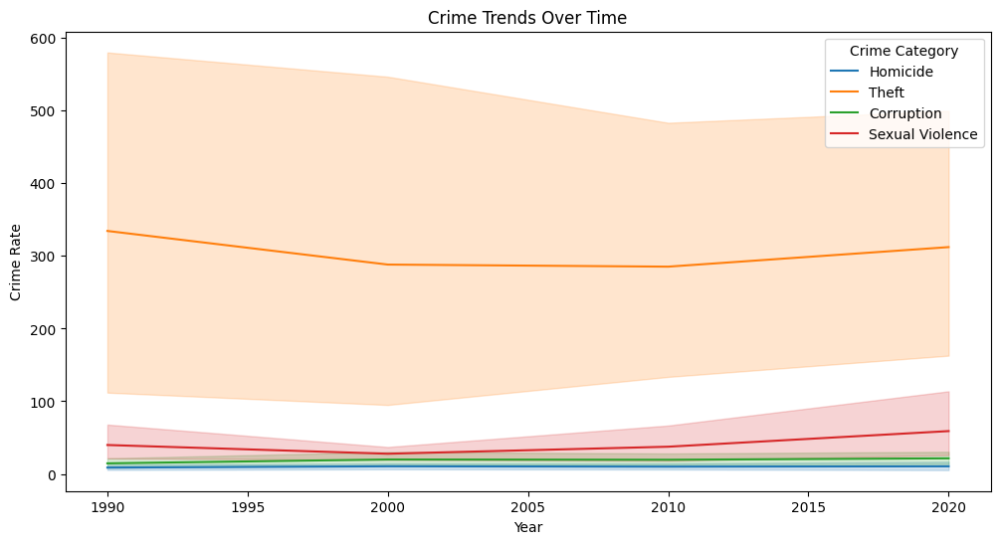

In [20]:
import matplotlib.pyplot as plt
import seaborn as sns


df_melted = df.melt(id_vars=['Country ', 'Crime Category'], 
                     value_vars=['C.1990', 'C.2000', 'C.2010', 'C.2020'],
                     var_name='Year', value_name='Crime Rate')


df_melted['Year'] = df_melted['Year'].str.extract('(\d+)').astype(int)

# Plot
plt.figure(figsize=(12, 6))
sns.lineplot(data=df_melted, x='Year', y='Crime Rate', hue='Crime Category')
plt.title("Crime Trends Over Time")
plt.show()


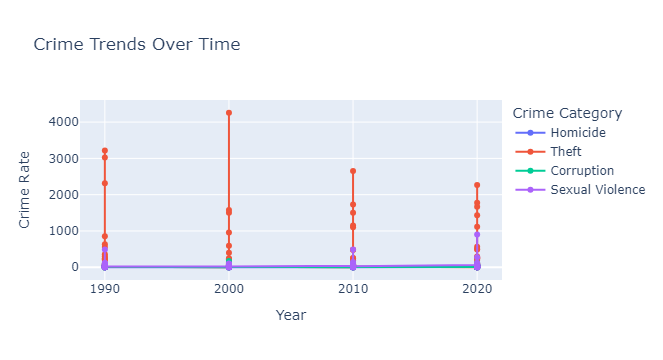

In [21]:


df_melted = df.melt(id_vars=['Country ', 'Crime Category'], 
                     value_vars=['C.1990', 'C.2000', 'C.2010', 'C.2020'],
                     var_name='Year', value_name='Crime Rate')


df_melted['Year'] = df_melted['Year'].str.extract('(\d+)').astype(int)


fig = px.line(df_melted, 
              x='Year', 
              y='Crime Rate', 
              color='Crime Category', 
              markers=True,
              title="Crime Trends Over Time",
              labels={'Crime Rate': 'Crime Rate', 'Year': 'Year'}
             )  

# Show interactive plot
fig.show()


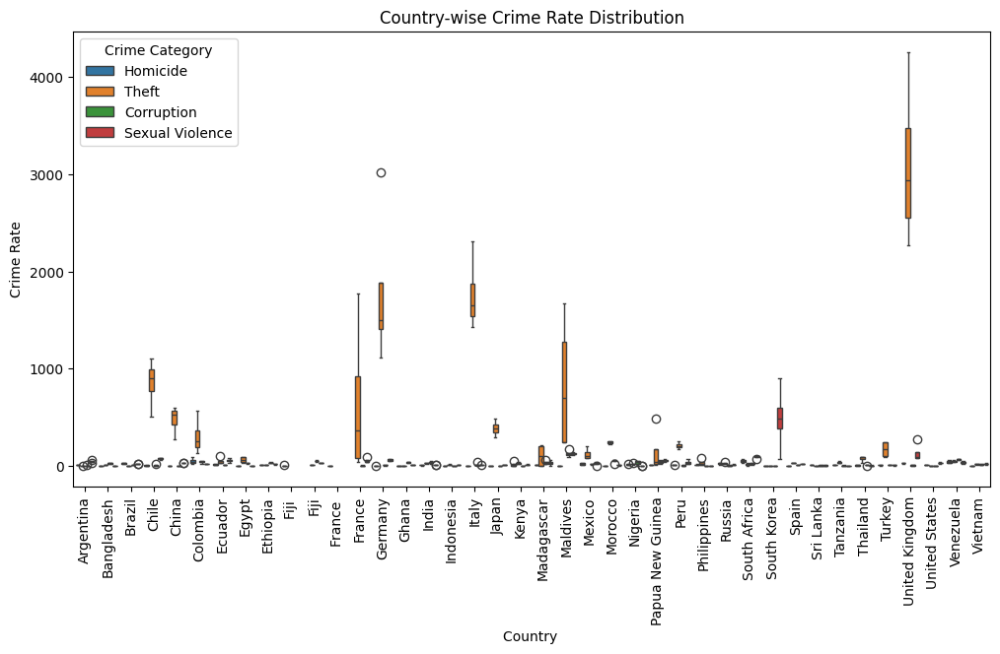

In [22]:
plt.figure(figsize=(12, 6))
sns.boxplot(data=df_melted, x='Country ', y='Crime Rate', hue='Crime Category')
plt.xticks(rotation=90)
plt.title("Country-wise Crime Rate Distribution")
plt.show()


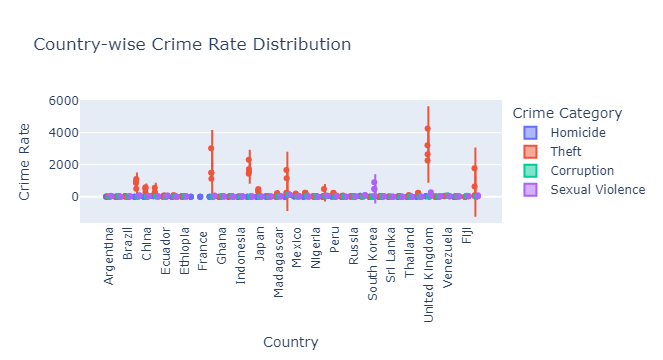

In [23]:
import plotly.express as px


fig = px.violin(df_melted, 
                x='Country ', 
                y='Crime Rate', 
                color='Crime Category', 
                box=True,  # Show box plot inside violin
                points="all",  # Show all points
                title="Country-wise Crime Rate Distribution")

fig.update_layout(xaxis_tickangle=-90)  
fig.show()


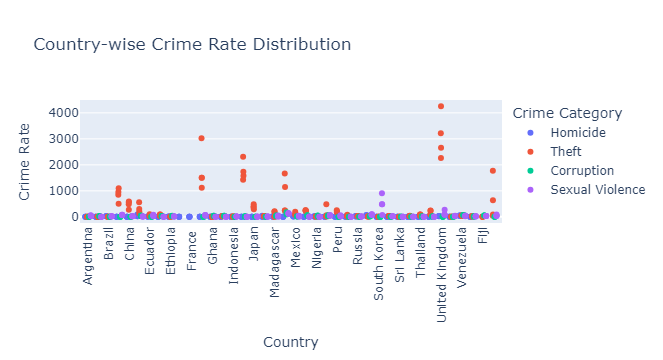

In [24]:
fig = px.strip(df_melted, 
               x='Country ', 
               y='Crime Rate', 
               color='Crime Category', 
               title="Country-wise Crime Rate Distribution")

fig.update_layout(xaxis_tickangle=-90)  # Rotate country labels
fig.show()


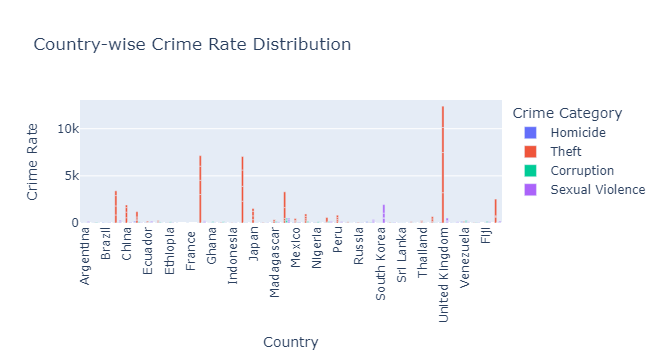

In [25]:
fig = px.bar(df_melted, 
             x='Country ', 
             y='Crime Rate', 
             color='Crime Category', 
             barmode='group', 
             title="Country-wise Crime Rate Distribution")

fig.update_layout(xaxis_tickangle=-90)  # Rotate labels for better readability
fig.show()


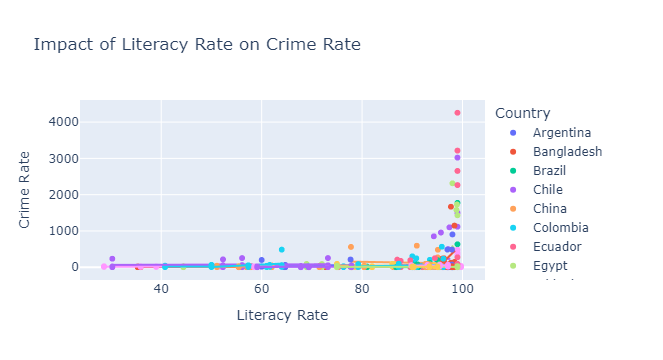

In [52]:
import plotly.express as px
import pandas as pd


df_crime = df.melt(id_vars=['Country ', 'Crime Category'], 
                    value_vars=['C.1990', 'C.2000', 'C.2010', 'C.2020'],
                    var_name='Year', value_name='Crime Rate')


df_literacy = df.melt(id_vars=['Country '], 
                      value_vars=['L.1990', 'L.2000', 'L.2010', 'L.2020'],
                      var_name='Year', value_name='Literacy Rate')


df_crime['Year'] = df_crime['Year'].str.extract('(\d+)').astype(int)
df_literacy['Year'] = df_literacy['Year'].str.extract('(\d+)').astype(int)


df_merged = pd.merge(df_crime, df_literacy, on=['Country ', 'Year'])


fig = px.scatter(df_merged, 
                 x='Literacy Rate', 
                 y='Crime Rate', 
                 color='Country ', 
                 size_max=10, 
                 hover_data=['Country ', 'Year', 'Crime Category'],
                 title="Impact of Literacy Rate on Crime Rate",
                 trendline="ols")  # Adds a trend line

fig.show()


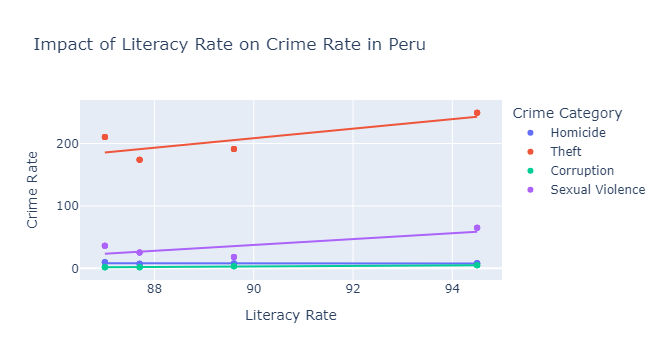

In [26]:
import plotly.express as px
import pandas as pd

# Filter for Peru
df_peru = df[df['Country '] == 'Peru']


df_crime = df_peru.melt(id_vars=['Country ', 'Crime Category'], 
                         value_vars=['C.1990', 'C.2000', 'C.2010', 'C.2020'],
                         var_name='Year', value_name='Crime Rate')


df_literacy = df_peru.melt(id_vars=['Country '], 
                            value_vars=['L.1990', 'L.2000', 'L.2010', 'L.2020'],
                            var_name='Year', value_name='Literacy Rate')


df_crime['Year'] = df_crime['Year'].str.extract('(\d+)').astype(int)
df_literacy['Year'] = df_literacy['Year'].str.extract('(\d+)').astype(int)


df_peru_merged = pd.merge(df_crime, df_literacy, on=['Country ', 'Year'])


fig = px.scatter(df_peru_merged, 
                 x='Literacy Rate', 
                 y='Crime Rate', 
                 color='Crime Category',  
                 size_max=10, 
                 hover_data=['Year', 'Crime Category'],
                 title="Impact of Literacy Rate on Crime Rate in Peru",
                 trendline="ols")  
fig.show()


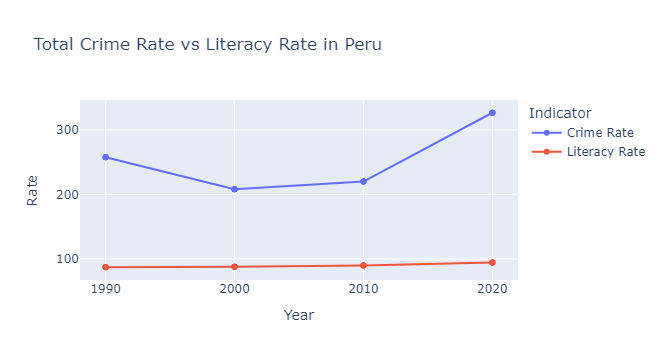

In [27]:


df_peru = df[df['Country '] == 'Peru']


df_crime = df_peru.melt(id_vars=['Country ', 'Crime Category'], 
                         value_vars=['C.1990', 'C.2000', 'C.2010', 'C.2020'],
                         var_name='Year', value_name='Crime Rate')


df_crime['Year'] = df_crime['Year'].str.extract('(\d+)').astype(int)


df_crime_sum = df_crime.groupby(['Country ', 'Year'])['Crime Rate'].sum().reset_index()


df_literacy = df_peru.melt(id_vars=['Country '], 
                            value_vars=['L.1990', 'L.2000', 'L.2010', 'L.2020'],
                            var_name='Year', value_name='Literacy Rate')


df_literacy['Year'] = df_literacy['Year'].str.extract('(\d+)').astype(int)


df_peru_merged = pd.merge(df_crime_sum, df_literacy, on=['Country ', 'Year'])


fig = px.line(df_peru_merged, x='Year', y=['Crime Rate', 'Literacy Rate'], 
              labels={'value': 'Rate', 'variable': 'Indicator'},
              markers=True, title="Total Crime Rate vs Literacy Rate in Peru")

fig.show()
#48% increase in crime rate in peru 

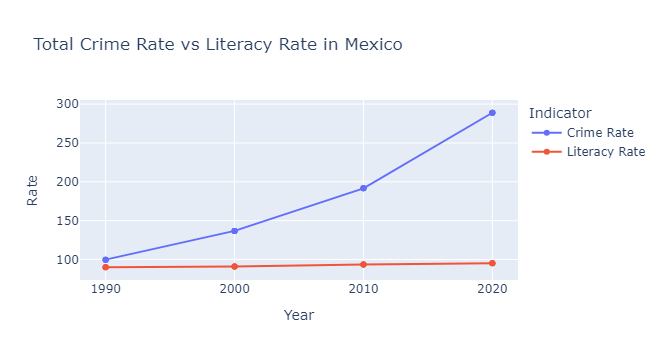

In [28]:
import plotly.express as px
import pandas as pd

df_peru = df[df['Country '] == 'Mexico']


df_crime = df_peru.melt(id_vars=['Country ', 'Crime Category'], 
                         value_vars=['C.1990', 'C.2000', 'C.2010', 'C.2020'],
                         var_name='Year', value_name='Crime Rate')


df_crime['Year'] = df_crime['Year'].str.extract('(\d+)').astype(int)


df_crime_sum = df_crime.groupby(['Country ', 'Year'])['Crime Rate'].sum().reset_index()


df_literacy = df_peru.melt(id_vars=['Country '], 
                            value_vars=['L.1990', 'L.2000', 'L.2010', 'L.2020'],
                            var_name='Year', value_name='Literacy Rate')


df_literacy['Year'] = df_literacy['Year'].str.extract('(\d+)').astype(int)


df_peru_merged = pd.merge(df_crime_sum, df_literacy, on=['Country ', 'Year'])


fig = px.line(df_peru_merged, x='Year', y=['Crime Rate', 'Literacy Rate'], 
              labels={'value': 'Rate', 'variable': 'Indicator'},
              markers=True, title="Total Crime Rate vs Literacy Rate in Mexico")

fig.show()
#10% increase in literacy rate 
#A Sharp 10%  decline in crime rate within 10 years 

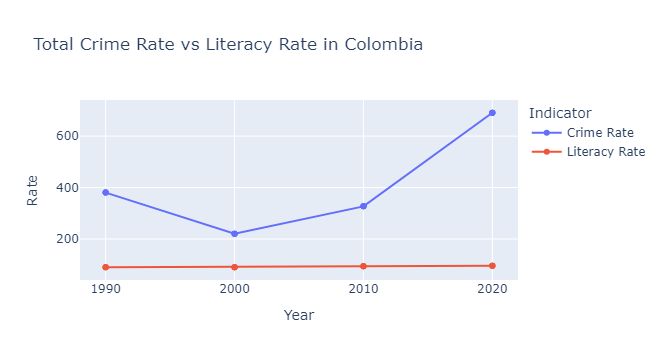

In [29]:
import plotly.express as px
import pandas as pd

df_peru = df[df['Country '] == 'Colombia']


df_crime = df_peru.melt(id_vars=['Country ', 'Crime Category'], 
                         value_vars=['C.1990', 'C.2000', 'C.2010', 'C.2020'],
                         var_name='Year', value_name='Crime Rate')


df_crime['Year'] = df_crime['Year'].str.extract('(\d+)').astype(int)


df_crime_sum = df_crime.groupby(['Country ', 'Year'])['Crime Rate'].sum().reset_index()


df_literacy = df_peru.melt(id_vars=['Country '], 
                            value_vars=['L.1990', 'L.2000', 'L.2010', 'L.2020'],
                            var_name='Year', value_name='Literacy Rate')


df_literacy['Year'] = df_literacy['Year'].str.extract('(\d+)').astype(int)


df_peru_merged = pd.merge(df_crime_sum, df_literacy, on=['Country ', 'Year'])


fig = px.line(df_peru_merged, x='Year', y=['Crime Rate', 'Literacy Rate'], 
              labels={'value': 'Rate', 'variable': 'Indicator'},
              markers=True, title="Total Crime Rate vs Literacy Rate in Colombia")

fig.show()
#10% increase in literacy rate 
#A Sharp 10%  decline in crime rate within 10 years 

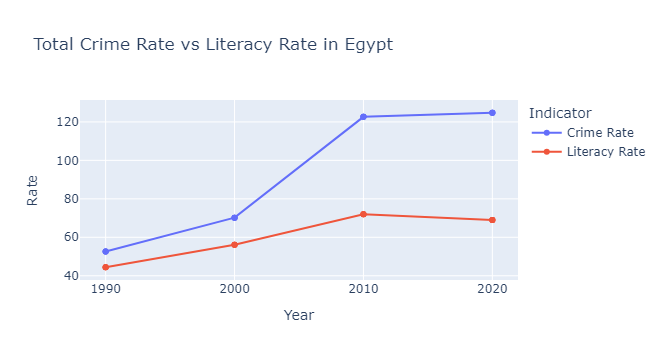

In [30]:
import plotly.express as px
import pandas as pd

df_peru = df[df['Country '] == 'Egypt']


df_crime = df_peru.melt(id_vars=['Country ', 'Crime Category'], 
                         value_vars=['C.1990', 'C.2000', 'C.2010', 'C.2020'],
                         var_name='Year', value_name='Crime Rate')


df_crime['Year'] = df_crime['Year'].str.extract('(\d+)').astype(int)


df_crime_sum = df_crime.groupby(['Country ', 'Year'])['Crime Rate'].sum().reset_index()


df_literacy = df_peru.melt(id_vars=['Country '], 
                            value_vars=['L.1990', 'L.2000', 'L.2010', 'L.2020'],
                            var_name='Year', value_name='Literacy Rate')


df_literacy['Year'] = df_literacy['Year'].str.extract('(\d+)').astype(int)


df_peru_merged = pd.merge(df_crime_sum, df_literacy, on=['Country ', 'Year'])


fig = px.line(df_peru_merged, x='Year', y=['Crime Rate', 'Literacy Rate'], 
              labels={'value': 'Rate', 'variable': 'Indicator'},
              markers=True, title="Total Crime Rate vs Literacy Rate in Egypt")

fig.show()
#10% increase in literacy rate 
#A Sharp 10%  decline in crime rate within 10 years 

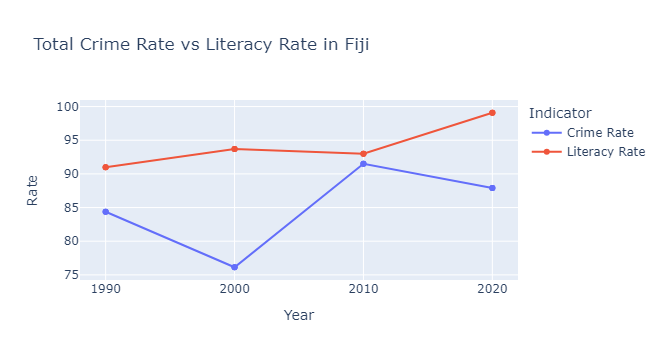

In [31]:
import plotly.express as px
import pandas as pd

df_peru = df[df['Country '] == 'Fiji']


df_crime = df_peru.melt(id_vars=['Country ', 'Crime Category'], 
                         value_vars=['C.1990', 'C.2000', 'C.2010', 'C.2020'],
                         var_name='Year', value_name='Crime Rate')


df_crime['Year'] = df_crime['Year'].str.extract('(\d+)').astype(int)


df_crime_sum = df_crime.groupby(['Country ', 'Year'])['Crime Rate'].sum().reset_index()


df_literacy = df_peru.melt(id_vars=['Country '], 
                            value_vars=['L.1990', 'L.2000', 'L.2010', 'L.2020'],
                            var_name='Year', value_name='Literacy Rate')


df_literacy['Year'] = df_literacy['Year'].str.extract('(\d+)').astype(int)


df_peru_merged = pd.merge(df_crime_sum, df_literacy, on=['Country ', 'Year'])


fig = px.line(df_peru_merged, x='Year', y=['Crime Rate', 'Literacy Rate'], 
              labels={'value': 'Rate', 'variable': 'Indicator'},
              markers=True, title="Total Crime Rate vs Literacy Rate in Fiji")

fig.show()
#10% increase in literacy rate 
#A Sharp 10%  decline in crime rate within 10 years 

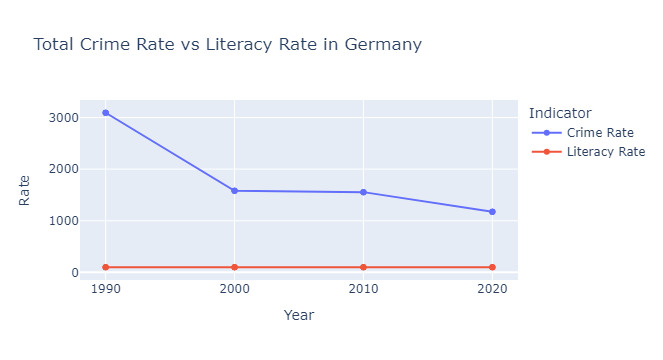

In [32]:
import plotly.express as px
import pandas as pd

df_peru = df[df['Country '] == 'Germany']


df_crime = df_peru.melt(id_vars=['Country ', 'Crime Category'], 
                         value_vars=['C.1990', 'C.2000', 'C.2010', 'C.2020'],
                         var_name='Year', value_name='Crime Rate')


df_crime['Year'] = df_crime['Year'].str.extract('(\d+)').astype(int)


df_crime_sum = df_crime.groupby(['Country ', 'Year'])['Crime Rate'].sum().reset_index()


df_literacy = df_peru.melt(id_vars=['Country '], 
                            value_vars=['L.1990', 'L.2000', 'L.2010', 'L.2020'],
                            var_name='Year', value_name='Literacy Rate')


df_literacy['Year'] = df_literacy['Year'].str.extract('(\d+)').astype(int)


df_peru_merged = pd.merge(df_crime_sum, df_literacy, on=['Country ', 'Year'])


fig = px.line(df_peru_merged, x='Year', y=['Crime Rate', 'Literacy Rate'], 
              labels={'value': 'Rate', 'variable': 'Indicator'},
              markers=True, title="Total Crime Rate vs Literacy Rate in Germany")

fig.show()
#10% increase in literacy rate 
#A Sharp 10%  decline in crime rate within 10 years 

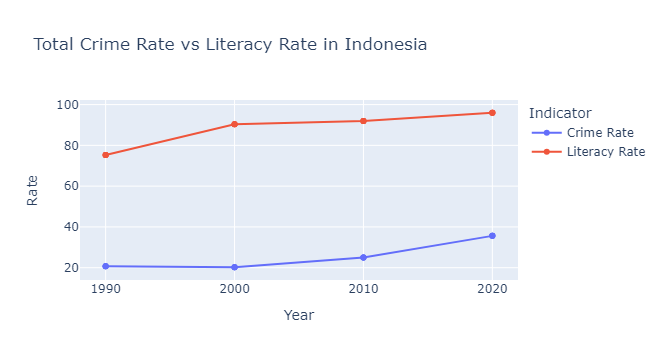

In [33]:
import plotly.express as px
import pandas as pd

df_peru = df[df['Country '] == 'Indonesia']


df_crime = df_peru.melt(id_vars=['Country ', 'Crime Category'], 
                         value_vars=['C.1990', 'C.2000', 'C.2010', 'C.2020'],
                         var_name='Year', value_name='Crime Rate')


df_crime['Year'] = df_crime['Year'].str.extract('(\d+)').astype(int)


df_crime_sum = df_crime.groupby(['Country ', 'Year'])['Crime Rate'].sum().reset_index()


df_literacy = df_peru.melt(id_vars=['Country '], 
                            value_vars=['L.1990', 'L.2000', 'L.2010', 'L.2020'],
                            var_name='Year', value_name='Literacy Rate')


df_literacy['Year'] = df_literacy['Year'].str.extract('(\d+)').astype(int)


df_peru_merged = pd.merge(df_crime_sum, df_literacy, on=['Country ', 'Year'])


fig = px.line(df_peru_merged, x='Year', y=['Crime Rate', 'Literacy Rate'], 
              labels={'value': 'Rate', 'variable': 'Indicator'},
              markers=True, title="Total Crime Rate vs Literacy Rate in Indonesia")

fig.show()
#10% increase in literacy rate 
#A Sharp 10%  decline in crime rate within 10 years 

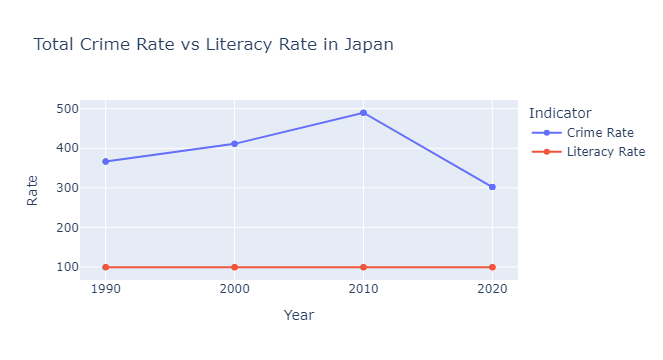

In [34]:
import plotly.express as px
import pandas as pd

df_peru = df[df['Country '] == 'Japan']


df_crime = df_peru.melt(id_vars=['Country ', 'Crime Category'], 
                         value_vars=['C.1990', 'C.2000', 'C.2010', 'C.2020'],
                         var_name='Year', value_name='Crime Rate')


df_crime['Year'] = df_crime['Year'].str.extract('(\d+)').astype(int)


df_crime_sum = df_crime.groupby(['Country ', 'Year'])['Crime Rate'].sum().reset_index()


df_literacy = df_peru.melt(id_vars=['Country '], 
                            value_vars=['L.1990', 'L.2000', 'L.2010', 'L.2020'],
                            var_name='Year', value_name='Literacy Rate')


df_literacy['Year'] = df_literacy['Year'].str.extract('(\d+)').astype(int)


df_peru_merged = pd.merge(df_crime_sum, df_literacy, on=['Country ', 'Year'])


fig = px.line(df_peru_merged, x='Year', y=['Crime Rate', 'Literacy Rate'], 
              labels={'value': 'Rate', 'variable': 'Indicator'},
              markers=True, title="Total Crime Rate vs Literacy Rate in Japan")

fig.show()
#10% increase in literacy rate 
#A Sharp 10%  decline in crime rate within 10 years 

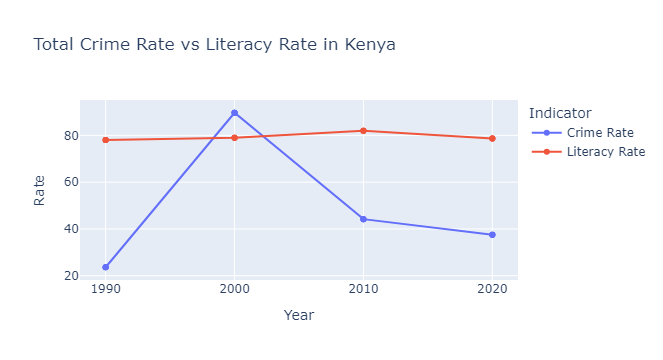

In [12]:
import plotly.express as px
import pandas as pd

df_peru = df[df['Country '] == 'Kenya']


df_crime = df_peru.melt(id_vars=['Country ', 'Crime Category'], 
                         value_vars=['C.1990', 'C.2000', 'C.2010', 'C.2020'],
                         var_name='Year', value_name='Crime Rate')


df_crime['Year'] = df_crime['Year'].str.extract('(\d+)').astype(int)


df_crime_sum = df_crime.groupby(['Country ', 'Year'])['Crime Rate'].sum().reset_index()


df_literacy = df_peru.melt(id_vars=['Country '], 
                            value_vars=['L.1990', 'L.2000', 'L.2010', 'L.2020'],
                            var_name='Year', value_name='Literacy Rate')


df_literacy['Year'] = df_literacy['Year'].str.extract('(\d+)').astype(int)


df_peru_merged = pd.merge(df_crime_sum, df_literacy, on=['Country ', 'Year'])


fig = px.line(df_peru_merged, x='Year', y=['Crime Rate', 'Literacy Rate'], 
              labels={'value': 'Rate', 'variable': 'Indicator'},
              markers=True, title="Total Crime Rate vs Literacy Rate in Kenya")

fig.show()
#10% increase in literacy rate 
#A Sharp 10%  decline in crime rate within 10 years 

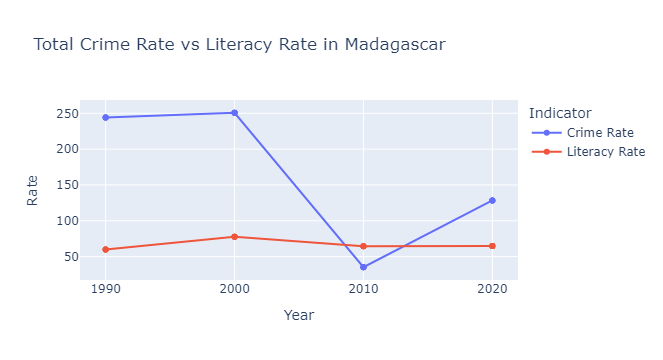

In [14]:
import plotly.express as px
import pandas as pd

df_peru = df[df['Country '] == 'Madagascar']


df_crime = df_peru.melt(id_vars=['Country ', 'Crime Category'], 
                         value_vars=['C.1990', 'C.2000', 'C.2010', 'C.2020'],
                         var_name='Year', value_name='Crime Rate')


df_crime['Year'] = df_crime['Year'].str.extract('(\d+)').astype(int)


df_crime_sum = df_crime.groupby(['Country ', 'Year'])['Crime Rate'].sum().reset_index()


df_literacy = df_peru.melt(id_vars=['Country '], 
                            value_vars=['L.1990', 'L.2000', 'L.2010', 'L.2020'],
                            var_name='Year', value_name='Literacy Rate')


df_literacy['Year'] = df_literacy['Year'].str.extract('(\d+)').astype(int)


df_peru_merged = pd.merge(df_crime_sum, df_literacy, on=['Country ', 'Year'])


fig = px.line(df_peru_merged, x='Year', y=['Crime Rate', 'Literacy Rate'], 
              labels={'value': 'Rate', 'variable': 'Indicator'},
              markers=True, title="Total Crime Rate vs Literacy Rate in Madagascar")

fig.show()
#10% increase in literacy rate 
#A Sharp 10%  decline in crime rate within 10 years 

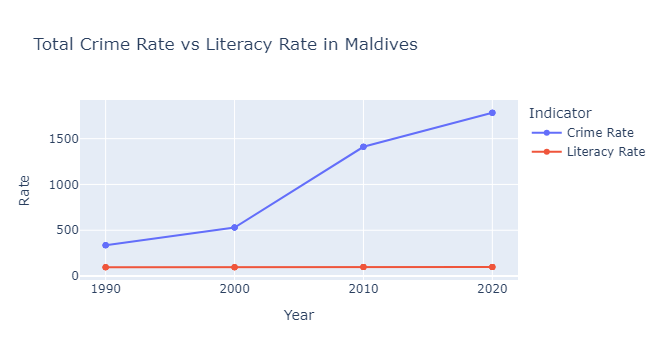

In [15]:
import plotly.express as px
import pandas as pd

df_peru = df[df['Country '] == 'Maldives']


df_crime = df_peru.melt(id_vars=['Country ', 'Crime Category'], 
                         value_vars=['C.1990', 'C.2000', 'C.2010', 'C.2020'],
                         var_name='Year', value_name='Crime Rate')


df_crime['Year'] = df_crime['Year'].str.extract('(\d+)').astype(int)


df_crime_sum = df_crime.groupby(['Country ', 'Year'])['Crime Rate'].sum().reset_index()


df_literacy = df_peru.melt(id_vars=['Country '], 
                            value_vars=['L.1990', 'L.2000', 'L.2010', 'L.2020'],
                            var_name='Year', value_name='Literacy Rate')


df_literacy['Year'] = df_literacy['Year'].str.extract('(\d+)').astype(int)


df_peru_merged = pd.merge(df_crime_sum, df_literacy, on=['Country ', 'Year'])


fig = px.line(df_peru_merged, x='Year', y=['Crime Rate', 'Literacy Rate'], 
              labels={'value': 'Rate', 'variable': 'Indicator'},
              markers=True, title="Total Crime Rate vs Literacy Rate in Maldives")

fig.show()
#10% increase in literacy rate 
#A Sharp 10%  decline in crime rate within 10 years 

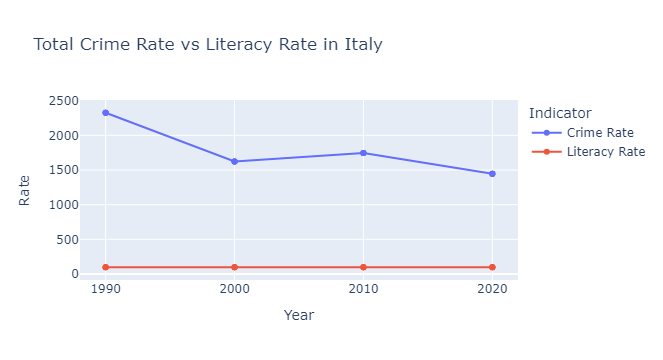

In [10]:
import plotly.express as px
import pandas as pd

df_peru = df[df['Country '] == 'Italy']


df_crime = df_peru.melt(id_vars=['Country ', 'Crime Category'], 
                         value_vars=['C.1990', 'C.2000', 'C.2010', 'C.2020'],
                         var_name='Year', value_name='Crime Rate')


df_crime['Year'] = df_crime['Year'].str.extract('(\d+)').astype(int)


df_crime_sum = df_crime.groupby(['Country ', 'Year'])['Crime Rate'].sum().reset_index()


df_literacy = df_peru.melt(id_vars=['Country '], 
                            value_vars=['L.1990', 'L.2000', 'L.2010', 'L.2020'],
                            var_name='Year', value_name='Literacy Rate')


df_literacy['Year'] = df_literacy['Year'].str.extract('(\d+)').astype(int)


df_peru_merged = pd.merge(df_crime_sum, df_literacy, on=['Country ', 'Year'])


fig = px.line(df_peru_merged, x='Year', y=['Crime Rate', 'Literacy Rate'], 
              labels={'value': 'Rate', 'variable': 'Indicator'},
              markers=True, title="Total Crime Rate vs Literacy Rate in Italy")

fig.show()
#10% increase in literacy rate 
#A Sharp 10%  decline in crime rate within 10 years 

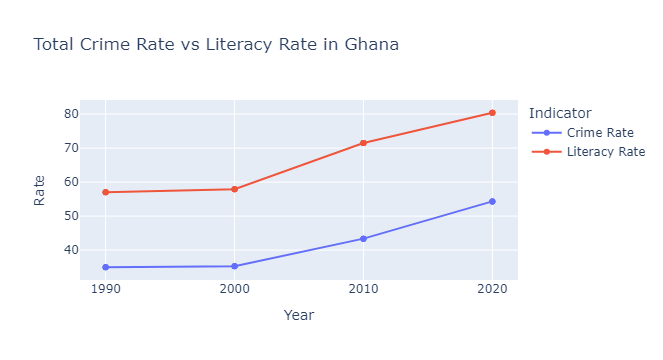

In [8]:
import plotly.express as px
import pandas as pd

df_peru = df[df['Country '] == 'Ghana']


df_crime = df_peru.melt(id_vars=['Country ', 'Crime Category'], 
                         value_vars=['C.1990', 'C.2000', 'C.2010', 'C.2020'],
                         var_name='Year', value_name='Crime Rate')


df_crime['Year'] = df_crime['Year'].str.extract('(\d+)').astype(int)


df_crime_sum = df_crime.groupby(['Country ', 'Year'])['Crime Rate'].sum().reset_index()


df_literacy = df_peru.melt(id_vars=['Country '], 
                            value_vars=['L.1990', 'L.2000', 'L.2010', 'L.2020'],
                            var_name='Year', value_name='Literacy Rate')


df_literacy['Year'] = df_literacy['Year'].str.extract('(\d+)').astype(int)


df_peru_merged = pd.merge(df_crime_sum, df_literacy, on=['Country ', 'Year'])


fig = px.line(df_peru_merged, x='Year', y=['Crime Rate', 'Literacy Rate'], 
              labels={'value': 'Rate', 'variable': 'Indicator'},
              markers=True, title="Total Crime Rate vs Literacy Rate in Ghana")

fig.show()
#10% increase in literacy rate 
#A Sharp 10%  decline in crime rate within 10 years 

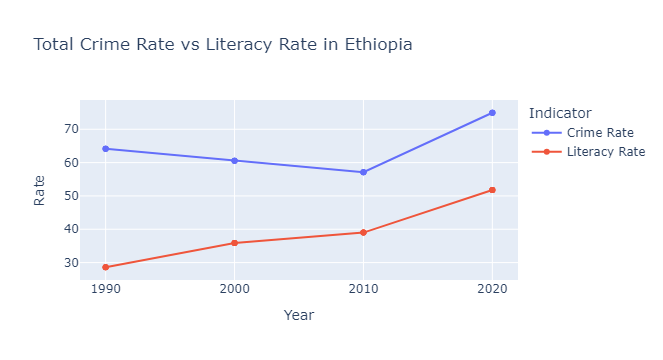

In [5]:
import plotly.express as px
import pandas as pd

df_peru = df[df['Country '] == 'Ethiopia']


df_crime = df_peru.melt(id_vars=['Country ', 'Crime Category'], 
                         value_vars=['C.1990', 'C.2000', 'C.2010', 'C.2020'],
                         var_name='Year', value_name='Crime Rate')


df_crime['Year'] = df_crime['Year'].str.extract('(\d+)').astype(int)


df_crime_sum = df_crime.groupby(['Country ', 'Year'])['Crime Rate'].sum().reset_index()


df_literacy = df_peru.melt(id_vars=['Country '], 
                            value_vars=['L.1990', 'L.2000', 'L.2010', 'L.2020'],
                            var_name='Year', value_name='Literacy Rate')


df_literacy['Year'] = df_literacy['Year'].str.extract('(\d+)').astype(int)


df_peru_merged = pd.merge(df_crime_sum, df_literacy, on=['Country ', 'Year'])


fig = px.line(df_peru_merged, x='Year', y=['Crime Rate', 'Literacy Rate'], 
              labels={'value': 'Rate', 'variable': 'Indicator'},
              markers=True, title="Total Crime Rate vs Literacy Rate in Ethiopia")

fig.show()
#10% increase in literacy rate 
#A Sharp 10%  decline in crime rate within 10 years 

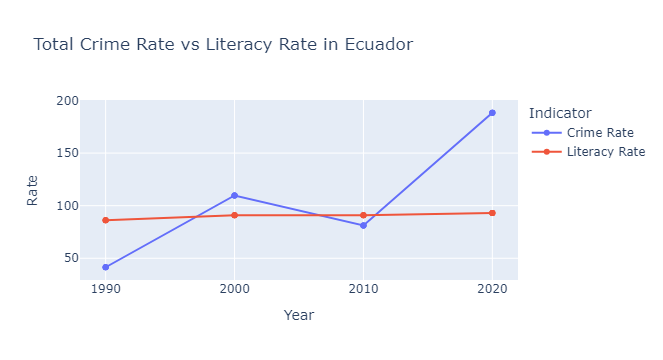

In [3]:
import plotly.express as px
import pandas as pd

df_peru = df[df['Country '] == 'Ecuador']


df_crime = df_peru.melt(id_vars=['Country ', 'Crime Category'], 
                         value_vars=['C.1990', 'C.2000', 'C.2010', 'C.2020'],
                         var_name='Year', value_name='Crime Rate')


df_crime['Year'] = df_crime['Year'].str.extract('(\d+)').astype(int)


df_crime_sum = df_crime.groupby(['Country ', 'Year'])['Crime Rate'].sum().reset_index()


df_literacy = df_peru.melt(id_vars=['Country '], 
                            value_vars=['L.1990', 'L.2000', 'L.2010', 'L.2020'],
                            var_name='Year', value_name='Literacy Rate')


df_literacy['Year'] = df_literacy['Year'].str.extract('(\d+)').astype(int)


df_peru_merged = pd.merge(df_crime_sum, df_literacy, on=['Country ', 'Year'])


fig = px.line(df_peru_merged, x='Year', y=['Crime Rate', 'Literacy Rate'], 
              labels={'value': 'Rate', 'variable': 'Indicator'},
              markers=True, title="Total Crime Rate vs Literacy Rate in Ecuador")

fig.show()
#10% increase in literacy rate 
#A Sharp 10%  decline in crime rate within 10 years 

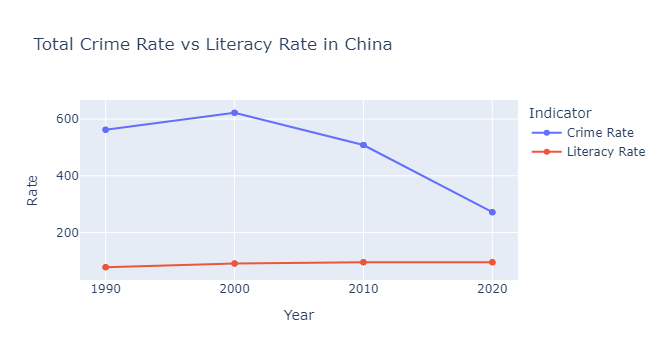

In [3]:
import plotly.express as px
import pandas as pd

df_peru = df[df['Country '] == 'China']


df_crime = df_peru.melt(id_vars=['Country ', 'Crime Category'], 
                         value_vars=['C.1990', 'C.2000', 'C.2010', 'C.2020'],
                         var_name='Year', value_name='Crime Rate')


df_crime['Year'] = df_crime['Year'].str.extract('(\d+)').astype(int)


df_crime_sum = df_crime.groupby(['Country ', 'Year'])['Crime Rate'].sum().reset_index()


df_literacy = df_peru.melt(id_vars=['Country '], 
                            value_vars=['L.1990', 'L.2000', 'L.2010', 'L.2020'],
                            var_name='Year', value_name='Literacy Rate')


df_literacy['Year'] = df_literacy['Year'].str.extract('(\d+)').astype(int)


df_peru_merged = pd.merge(df_crime_sum, df_literacy, on=['Country ', 'Year'])


fig = px.line(df_peru_merged, x='Year', y=['Crime Rate', 'Literacy Rate'], 
              labels={'value': 'Rate', 'variable': 'Indicator'},
              markers=True, title="Total Crime Rate vs Literacy Rate in China")

fig.show()
#10% increase in literacy rate 
#A Sharp 10%  decline in crime rate within 10 years 

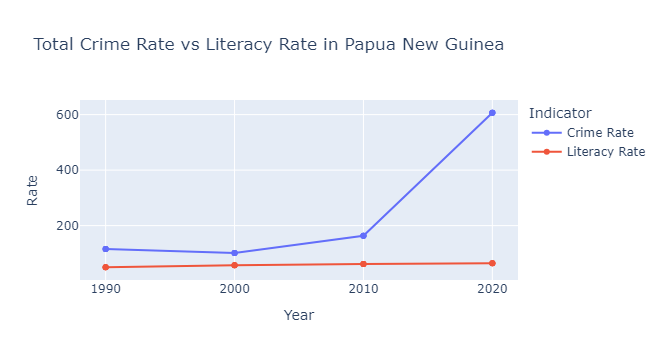

In [7]:
import plotly.express as px
import pandas as pd

df_peru = df[df['Country '] == 'Papua New Guinea']


df_crime = df_peru.melt(id_vars=['Country ', 'Crime Category'], 
                         value_vars=['C.1990', 'C.2000', 'C.2010', 'C.2020'],
                         var_name='Year', value_name='Crime Rate')


df_crime['Year'] = df_crime['Year'].str.extract('(\d+)').astype(int)


df_crime_sum = df_crime.groupby(['Country ', 'Year'])['Crime Rate'].sum().reset_index()


df_literacy = df_peru.melt(id_vars=['Country '], 
                            value_vars=['L.1990', 'L.2000', 'L.2010', 'L.2020'],
                            var_name='Year', value_name='Literacy Rate')


df_literacy['Year'] = df_literacy['Year'].str.extract('(\d+)').astype(int)


df_peru_merged = pd.merge(df_crime_sum, df_literacy, on=['Country ', 'Year'])


fig = px.line(df_peru_merged, x='Year', y=['Crime Rate', 'Literacy Rate'], 
              labels={'value': 'Rate', 'variable': 'Indicator'},
              markers=True, title="Total Crime Rate vs Literacy Rate in Papua New Guinea")

fig.show()
#10% increase in literacy rate 
#A Sharp 10%  decline in crime rate within 10 years 

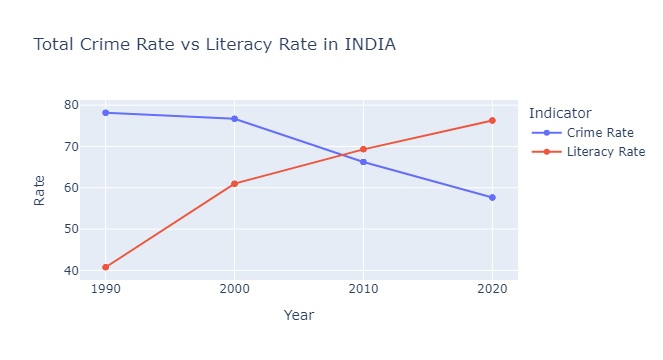

In [20]:

df_peru = df[df['Country '] == 'India']


df_crime = df_peru.melt(id_vars=['Country ', 'Crime Category'], 
                         value_vars=['C.1990', 'C.2000', 'C.2010', 'C.2020'],
                         var_name='Year', value_name='Crime Rate')


df_crime['Year'] = df_crime['Year'].str.extract('(\d+)').astype(int)


df_crime_sum = df_crime.groupby(['Country ', 'Year'])['Crime Rate'].sum().reset_index()


df_literacy = df_peru.melt(id_vars=['Country '], 
                            value_vars=['L.1990', 'L.2000', 'L.2010', 'L.2020'],
                            var_name='Year', value_name='Literacy Rate')


df_literacy['Year'] = df_literacy['Year'].str.extract('(\d+)').astype(int)


df_peru_merged = pd.merge(df_crime_sum, df_literacy, on=['Country ', 'Year'])


fig = px.line(df_peru_merged, x='Year', y=['Crime Rate', 'Literacy Rate'], 
              labels={'value': 'Rate', 'variable': 'Indicator'},
              markers=True, title="Total Crime Rate vs Literacy Rate in INDIA")

fig.show()
#10% increase in literacy rate 
#A Sharp 10%  decline in crime rate within 10 years 

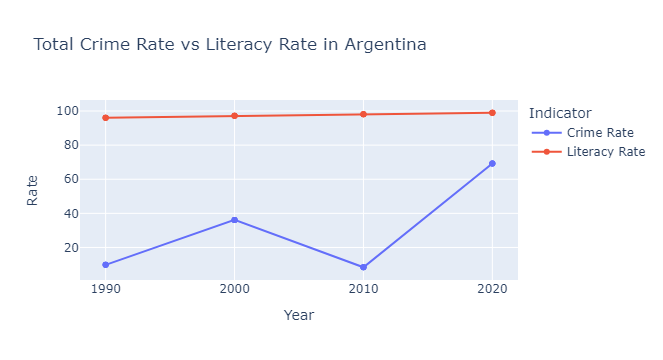

In [4]:
import plotly.express as px
import pandas as pd
df_peru = df[df['Country '] == 'Argentina']


df_crime = df_peru.melt(id_vars=['Country ', 'Crime Category'], 
                         value_vars=['C.1990', 'C.2000', 'C.2010', 'C.2020'],
                         var_name='Year', value_name='Crime Rate')


df_crime['Year'] = df_crime['Year'].str.extract('(\d+)').astype(int)


df_crime_sum = df_crime.groupby(['Country ', 'Year'])['Crime Rate'].sum().reset_index()


df_literacy = df_peru.melt(id_vars=['Country '], 
                            value_vars=['L.1990', 'L.2000', 'L.2010', 'L.2020'],
                            var_name='Year', value_name='Literacy Rate')


df_literacy['Year'] = df_literacy['Year'].str.extract('(\d+)').astype(int)


df_peru_merged = pd.merge(df_crime_sum, df_literacy, on=['Country ', 'Year'])


fig = px.line(df_peru_merged, x='Year', y=['Crime Rate', 'Literacy Rate'], 
              labels={'value': 'Rate', 'variable': 'Indicator'},
              markers=True, title="Total Crime Rate vs Literacy Rate in Argentina")

fig.show()

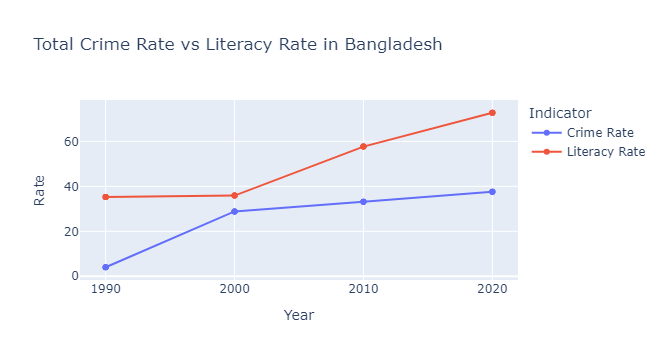

In [3]:
import plotly.express as px
import pandas as pd
df_peru = df[df['Country '] == 'Bangladesh']


df_crime = df_peru.melt(id_vars=['Country ', 'Crime Category'], 
                         value_vars=['C.1990', 'C.2000', 'C.2010', 'C.2020'],
                         var_name='Year', value_name='Crime Rate')


df_crime['Year'] = df_crime['Year'].str.extract('(\d+)').astype(int)


df_crime_sum = df_crime.groupby(['Country ', 'Year'])['Crime Rate'].sum().reset_index()


df_literacy = df_peru.melt(id_vars=['Country '], 
                            value_vars=['L.1990', 'L.2000', 'L.2010', 'L.2020'],
                            var_name='Year', value_name='Literacy Rate')


df_literacy['Year'] = df_literacy['Year'].str.extract('(\d+)').astype(int)


df_peru_merged = pd.merge(df_crime_sum, df_literacy, on=['Country ', 'Year'])


fig = px.line(df_peru_merged, x='Year', y=['Crime Rate', 'Literacy Rate'], 
              labels={'value': 'Rate', 'variable': 'Indicator'},
              markers=True, title="Total Crime Rate vs Literacy Rate in Bangladesh")

fig.show()

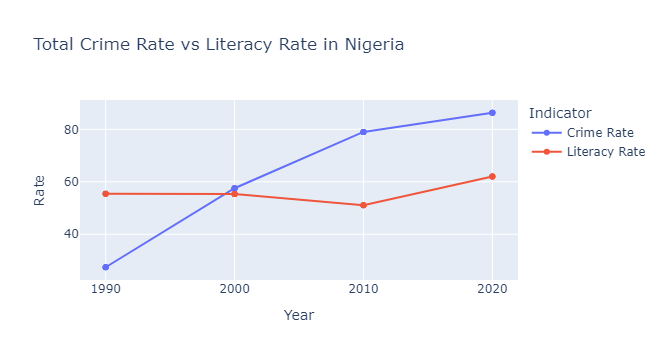

In [8]:
import plotly.express as px
import pandas as pd
df_peru = df[df['Country '] == 'Nigeria']


df_crime = df_peru.melt(id_vars=['Country ', 'Crime Category'], 
                         value_vars=['C.1990', 'C.2000', 'C.2010', 'C.2020'],
                         var_name='Year', value_name='Crime Rate')


df_crime['Year'] = df_crime['Year'].str.extract('(\d+)').astype(int)


df_crime_sum = df_crime.groupby(['Country ', 'Year'])['Crime Rate'].sum().reset_index()


df_literacy = df_peru.melt(id_vars=['Country '], 
                            value_vars=['L.1990', 'L.2000', 'L.2010', 'L.2020'],
                            var_name='Year', value_name='Literacy Rate')


df_literacy['Year'] = df_literacy['Year'].str.extract('(\d+)').astype(int)


df_peru_merged = pd.merge(df_crime_sum, df_literacy, on=['Country ', 'Year'])


fig = px.line(df_peru_merged, x='Year', y=['Crime Rate', 'Literacy Rate'], 
              labels={'value': 'Rate', 'variable': 'Indicator'},
              markers=True, title="Total Crime Rate vs Literacy Rate in Nigeria")

fig.show()

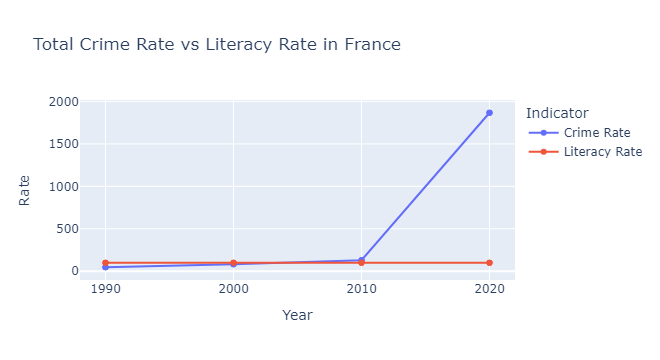

In [6]:
import plotly.express as px
import pandas as pd
df_peru = df[df['Country '] == 'France']


df_crime = df_peru.melt(id_vars=['Country ', 'Crime Category'], 
                         value_vars=['C.1990', 'C.2000', 'C.2010', 'C.2020'],
                         var_name='Year', value_name='Crime Rate')


df_crime['Year'] = df_crime['Year'].str.extract('(\d+)').astype(int)


df_crime_sum = df_crime.groupby(['Country ', 'Year'])['Crime Rate'].sum().reset_index()


df_literacy = df_peru.melt(id_vars=['Country '], 
                            value_vars=['L.1990', 'L.2000', 'L.2010', 'L.2020'],
                            var_name='Year', value_name='Literacy Rate')


df_literacy['Year'] = df_literacy['Year'].str.extract('(\d+)').astype(int)


df_peru_merged = pd.merge(df_crime_sum, df_literacy, on=['Country ', 'Year'])


fig = px.line(df_peru_merged, x='Year', y=['Crime Rate', 'Literacy Rate'], 
              labels={'value': 'Rate', 'variable': 'Indicator'},
              markers=True, title="Total Crime Rate vs Literacy Rate in France")

fig.show()

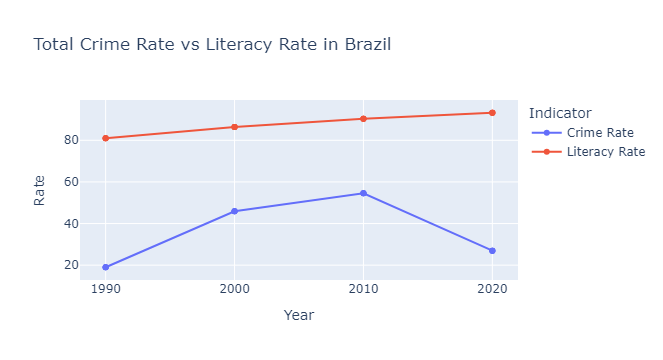

In [6]:
import plotly.express as px
import pandas as pd
df_peru = df[df['Country '] == 'Brazil']


df_crime = df_peru.melt(id_vars=['Country ', 'Crime Category'], 
                         value_vars=['C.1990', 'C.2000', 'C.2010', 'C.2020'],
                         var_name='Year', value_name='Crime Rate')


df_crime['Year'] = df_crime['Year'].str.extract('(\d+)').astype(int)


df_crime_sum = df_crime.groupby(['Country ', 'Year'])['Crime Rate'].sum().reset_index()


df_literacy = df_peru.melt(id_vars=['Country '], 
                            value_vars=['L.1990', 'L.2000', 'L.2010', 'L.2020'],
                            var_name='Year', value_name='Literacy Rate')


df_literacy['Year'] = df_literacy['Year'].str.extract('(\d+)').astype(int)


df_peru_merged = pd.merge(df_crime_sum, df_literacy, on=['Country ', 'Year'])


fig = px.line(df_peru_merged, x='Year', y=['Crime Rate', 'Literacy Rate'], 
              labels={'value': 'Rate', 'variable': 'Indicator'},
              markers=True, title="Total Crime Rate vs Literacy Rate in Brazil")

fig.show()

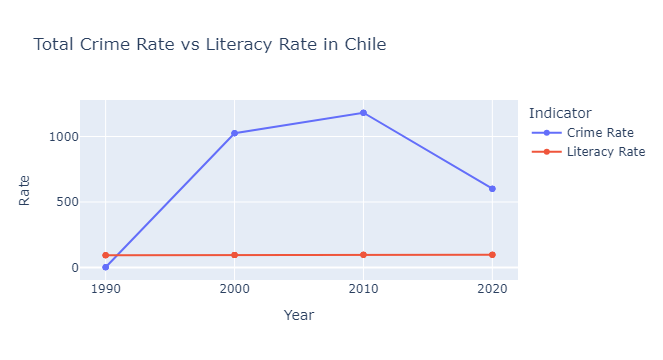

In [7]:
import plotly.express as px
import pandas as pd
df_peru = df[df['Country '] == 'Chile']


df_crime = df_peru.melt(id_vars=['Country ', 'Crime Category'], 
                         value_vars=['C.1990', 'C.2000', 'C.2010', 'C.2020'],
                         var_name='Year', value_name='Crime Rate')


df_crime['Year'] = df_crime['Year'].str.extract('(\d+)').astype(int)


df_crime_sum = df_crime.groupby(['Country ', 'Year'])['Crime Rate'].sum().reset_index()


df_literacy = df_peru.melt(id_vars=['Country '], 
                            value_vars=['L.1990', 'L.2000', 'L.2010', 'L.2020'],
                            var_name='Year', value_name='Literacy Rate')


df_literacy['Year'] = df_literacy['Year'].str.extract('(\d+)').astype(int)


df_peru_merged = pd.merge(df_crime_sum, df_literacy, on=['Country ', 'Year'])


fig = px.line(df_peru_merged, x='Year', y=['Crime Rate', 'Literacy Rate'], 
              labels={'value': 'Rate', 'variable': 'Indicator'},
              markers=True, title="Total Crime Rate vs Literacy Rate in Chile")

fig.show()

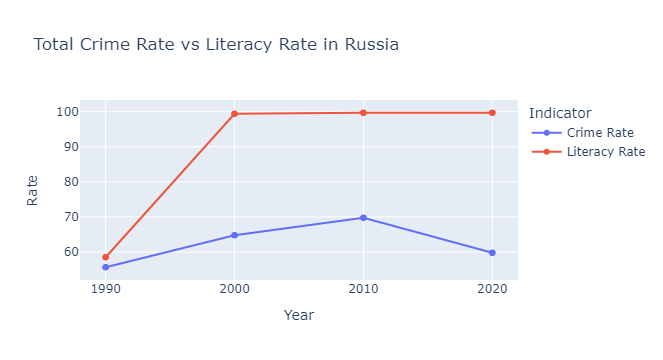

In [10]:
import plotly.express as px
import pandas as pd
df_peru = df[df['Country '] == 'Russia']


df_crime = df_peru.melt(id_vars=['Country ', 'Crime Category'], 
                         value_vars=['C.1990', 'C.2000', 'C.2010', 'C.2020'],
                         var_name='Year', value_name='Crime Rate')


df_crime['Year'] = df_crime['Year'].str.extract('(\d+)').astype(int)


df_crime_sum = df_crime.groupby(['Country ', 'Year'])['Crime Rate'].sum().reset_index()


df_literacy = df_peru.melt(id_vars=['Country '], 
                            value_vars=['L.1990', 'L.2000', 'L.2010', 'L.2020'],
                            var_name='Year', value_name='Literacy Rate')


df_literacy['Year'] = df_literacy['Year'].str.extract('(\d+)').astype(int)


df_peru_merged = pd.merge(df_crime_sum, df_literacy, on=['Country ', 'Year'])


fig = px.line(df_peru_merged, x='Year', y=['Crime Rate', 'Literacy Rate'], 
              labels={'value': 'Rate', 'variable': 'Indicator'},
              markers=True, title="Total Crime Rate vs Literacy Rate in Russia")

fig.show()

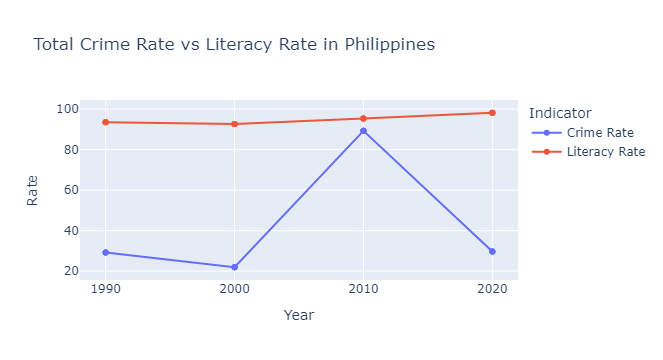

In [9]:
import plotly.express as px
import pandas as pd
df_peru = df[df['Country '] == 'Philippines']


df_crime = df_peru.melt(id_vars=['Country ', 'Crime Category'], 
                         value_vars=['C.1990', 'C.2000', 'C.2010', 'C.2020'],
                         var_name='Year', value_name='Crime Rate')


df_crime['Year'] = df_crime['Year'].str.extract('(\d+)').astype(int)


df_crime_sum = df_crime.groupby(['Country ', 'Year'])['Crime Rate'].sum().reset_index()


df_literacy = df_peru.melt(id_vars=['Country '], 
                            value_vars=['L.1990', 'L.2000', 'L.2010', 'L.2020'],
                            var_name='Year', value_name='Literacy Rate')


df_literacy['Year'] = df_literacy['Year'].str.extract('(\d+)').astype(int)


df_peru_merged = pd.merge(df_crime_sum, df_literacy, on=['Country ', 'Year'])


fig = px.line(df_peru_merged, x='Year', y=['Crime Rate', 'Literacy Rate'], 
              labels={'value': 'Rate', 'variable': 'Indicator'},
              markers=True, title="Total Crime Rate vs Literacy Rate in Philippines")

fig.show()

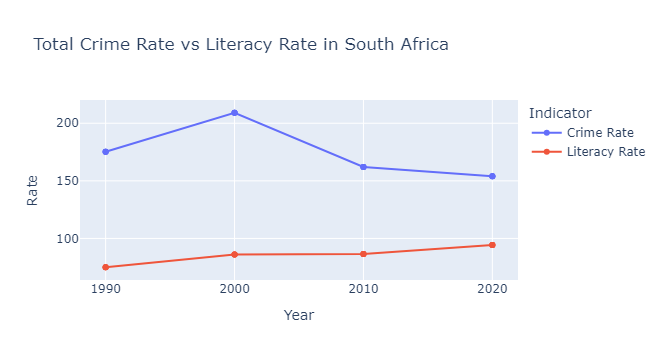

In [11]:
import plotly.express as px
import pandas as pd
df_peru = df[df['Country '] == 'South Africa']


df_crime = df_peru.melt(id_vars=['Country ', 'Crime Category'], 
                         value_vars=['C.1990', 'C.2000', 'C.2010', 'C.2020'],
                         var_name='Year', value_name='Crime Rate')


df_crime['Year'] = df_crime['Year'].str.extract('(\d+)').astype(int)


df_crime_sum = df_crime.groupby(['Country ', 'Year'])['Crime Rate'].sum().reset_index()


df_literacy = df_peru.melt(id_vars=['Country '], 
                            value_vars=['L.1990', 'L.2000', 'L.2010', 'L.2020'],
                            var_name='Year', value_name='Literacy Rate')


df_literacy['Year'] = df_literacy['Year'].str.extract('(\d+)').astype(int)


df_peru_merged = pd.merge(df_crime_sum, df_literacy, on=['Country ', 'Year'])


fig = px.line(df_peru_merged, x='Year', y=['Crime Rate', 'Literacy Rate'], 
              labels={'value': 'Rate', 'variable': 'Indicator'},
              markers=True, title="Total Crime Rate vs Literacy Rate in South Africa")

fig.show()

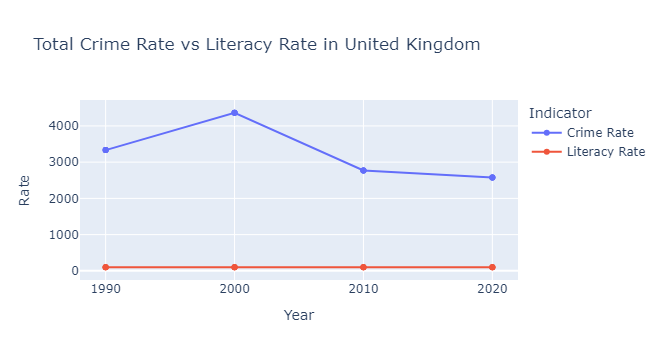

In [21]:
import plotly.express as px
import pandas as pd
df_peru = df[df['Country '] == 'United Kingdom']


df_crime = df_peru.melt(id_vars=['Country ', 'Crime Category'], 
                         value_vars=['C.1990', 'C.2000', 'C.2010', 'C.2020'],
                         var_name='Year', value_name='Crime Rate')


df_crime['Year'] = df_crime['Year'].str.extract('(\d+)').astype(int)


df_crime_sum = df_crime.groupby(['Country ', 'Year'])['Crime Rate'].sum().reset_index()


df_literacy = df_peru.melt(id_vars=['Country '], 
                            value_vars=['L.1990', 'L.2000', 'L.2010', 'L.2020'],
                            var_name='Year', value_name='Literacy Rate')


df_literacy['Year'] = df_literacy['Year'].str.extract('(\d+)').astype(int)


df_peru_merged = pd.merge(df_crime_sum, df_literacy, on=['Country ', 'Year'])


fig = px.line(df_peru_merged, x='Year', y=['Crime Rate', 'Literacy Rate'], 
              labels={'value': 'Rate', 'variable': 'Indicator'},
              markers=True, title="Total Crime Rate vs Literacy Rate in United Kingdom")

fig.show()

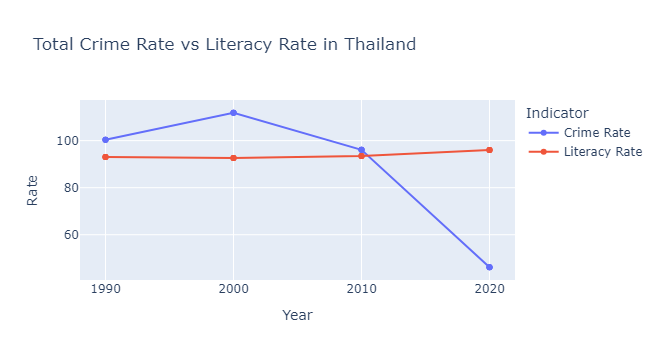

In [19]:
import plotly.express as px
import pandas as pd
df_peru = df[df['Country '] == 'Thailand']


df_crime = df_peru.melt(id_vars=['Country ', 'Crime Category'], 
                         value_vars=['C.1990', 'C.2000', 'C.2010', 'C.2020'],
                         var_name='Year', value_name='Crime Rate')


df_crime['Year'] = df_crime['Year'].str.extract('(\d+)').astype(int)


df_crime_sum = df_crime.groupby(['Country ', 'Year'])['Crime Rate'].sum().reset_index()


df_literacy = df_peru.melt(id_vars=['Country '], 
                            value_vars=['L.1990', 'L.2000', 'L.2010', 'L.2020'],
                            var_name='Year', value_name='Literacy Rate')


df_literacy['Year'] = df_literacy['Year'].str.extract('(\d+)').astype(int)


df_peru_merged = pd.merge(df_crime_sum, df_literacy, on=['Country ', 'Year'])


fig = px.line(df_peru_merged, x='Year', y=['Crime Rate', 'Literacy Rate'], 
              labels={'value': 'Rate', 'variable': 'Indicator'},
              markers=True, title="Total Crime Rate vs Literacy Rate in Thailand")

fig.show()

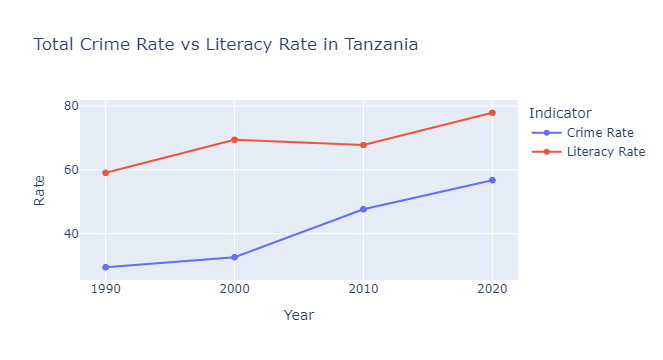

In [18]:
import plotly.express as px
import pandas as pd
df_peru = df[df['Country '] == 'Tanzania']


df_crime = df_peru.melt(id_vars=['Country ', 'Crime Category'], 
                         value_vars=['C.1990', 'C.2000', 'C.2010', 'C.2020'],
                         var_name='Year', value_name='Crime Rate')


df_crime['Year'] = df_crime['Year'].str.extract('(\d+)').astype(int)


df_crime_sum = df_crime.groupby(['Country ', 'Year'])['Crime Rate'].sum().reset_index()


df_literacy = df_peru.melt(id_vars=['Country '], 
                            value_vars=['L.1990', 'L.2000', 'L.2010', 'L.2020'],
                            var_name='Year', value_name='Literacy Rate')


df_literacy['Year'] = df_literacy['Year'].str.extract('(\d+)').astype(int)


df_peru_merged = pd.merge(df_crime_sum, df_literacy, on=['Country ', 'Year'])


fig = px.line(df_peru_merged, x='Year', y=['Crime Rate', 'Literacy Rate'], 
              labels={'value': 'Rate', 'variable': 'Indicator'},
              markers=True, title="Total Crime Rate vs Literacy Rate in Tanzania")

fig.show()

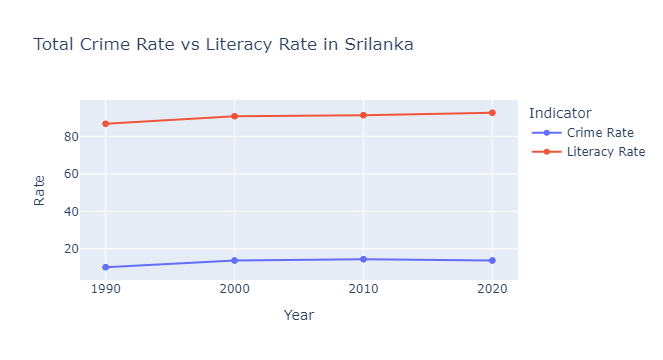

In [17]:
import plotly.express as px
import pandas as pd
df_peru = df[df['Country '] == 'Sri Lanka']


df_crime = df_peru.melt(id_vars=['Country ', 'Crime Category'], 
                         value_vars=['C.1990', 'C.2000', 'C.2010', 'C.2020'],
                         var_name='Year', value_name='Crime Rate')


df_crime['Year'] = df_crime['Year'].str.extract('(\d+)').astype(int)


df_crime_sum = df_crime.groupby(['Country ', 'Year'])['Crime Rate'].sum().reset_index()


df_literacy = df_peru.melt(id_vars=['Country '], 
                            value_vars=['L.1990', 'L.2000', 'L.2010', 'L.2020'],
                            var_name='Year', value_name='Literacy Rate')


df_literacy['Year'] = df_literacy['Year'].str.extract('(\d+)').astype(int)


df_peru_merged = pd.merge(df_crime_sum, df_literacy, on=['Country ', 'Year'])


fig = px.line(df_peru_merged, x='Year', y=['Crime Rate', 'Literacy Rate'], 
              labels={'value': 'Rate', 'variable': 'Indicator'},
              markers=True, title="Total Crime Rate vs Literacy Rate in Srilanka")

fig.show()

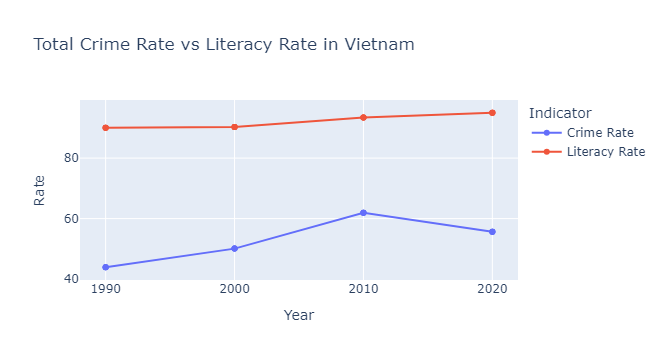

In [24]:
import plotly.express as px
import pandas as pd
df_peru = df[df['Country '] == 'Vietnam']


df_crime = df_peru.melt(id_vars=['Country ', 'Crime Category'], 
                         value_vars=['C.1990', 'C.2000', 'C.2010', 'C.2020'],
                         var_name='Year', value_name='Crime Rate')


df_crime['Year'] = df_crime['Year'].str.extract('(\d+)').astype(int)


df_crime_sum = df_crime.groupby(['Country ', 'Year'])['Crime Rate'].sum().reset_index()


df_literacy = df_peru.melt(id_vars=['Country '], 
                            value_vars=['L.1990', 'L.2000', 'L.2010', 'L.2020'],
                            var_name='Year', value_name='Literacy Rate')


df_literacy['Year'] = df_literacy['Year'].str.extract('(\d+)').astype(int)


df_peru_merged = pd.merge(df_crime_sum, df_literacy, on=['Country ', 'Year'])


fig = px.line(df_peru_merged, x='Year', y=['Crime Rate', 'Literacy Rate'], 
              labels={'value': 'Rate', 'variable': 'Indicator'},
              markers=True, title="Total Crime Rate vs Literacy Rate in Vietnam")

fig.show()

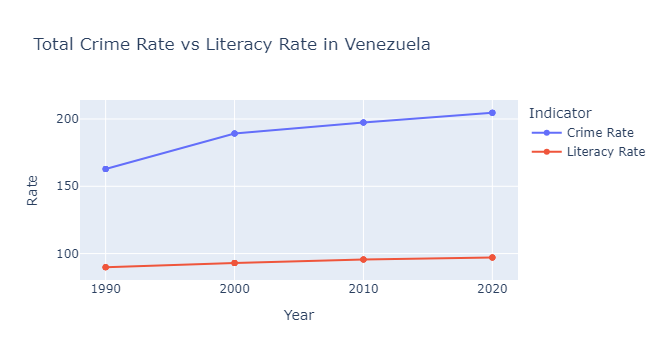

In [23]:
import plotly.express as px
import pandas as pd
df_peru = df[df['Country '] == 'Venezuela']


df_crime = df_peru.melt(id_vars=['Country ', 'Crime Category'], 
                         value_vars=['C.1990', 'C.2000', 'C.2010', 'C.2020'],
                         var_name='Year', value_name='Crime Rate')


df_crime['Year'] = df_crime['Year'].str.extract('(\d+)').astype(int)


df_crime_sum = df_crime.groupby(['Country ', 'Year'])['Crime Rate'].sum().reset_index()


df_literacy = df_peru.melt(id_vars=['Country '], 
                            value_vars=['L.1990', 'L.2000', 'L.2010', 'L.2020'],
                            var_name='Year', value_name='Literacy Rate')


df_literacy['Year'] = df_literacy['Year'].str.extract('(\d+)').astype(int)


df_peru_merged = pd.merge(df_crime_sum, df_literacy, on=['Country ', 'Year'])


fig = px.line(df_peru_merged, x='Year', y=['Crime Rate', 'Literacy Rate'], 
              labels={'value': 'Rate', 'variable': 'Indicator'},
              markers=True, title="Total Crime Rate vs Literacy Rate in Venezuela")

fig.show()

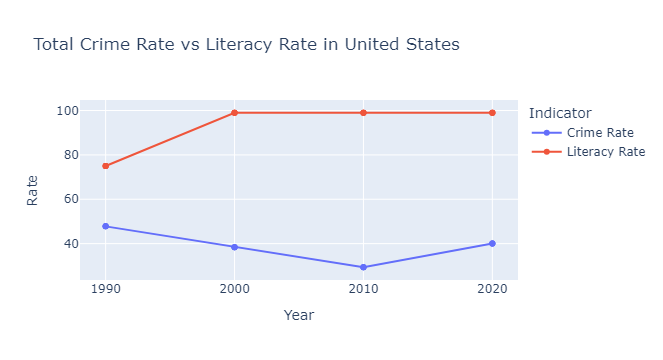

In [22]:
import plotly.express as px
import pandas as pd
df_peru = df[df['Country '] == 'United States']


df_crime = df_peru.melt(id_vars=['Country ', 'Crime Category'], 
                         value_vars=['C.1990', 'C.2000', 'C.2010', 'C.2020'],
                         var_name='Year', value_name='Crime Rate')


df_crime['Year'] = df_crime['Year'].str.extract('(\d+)').astype(int)


df_crime_sum = df_crime.groupby(['Country ', 'Year'])['Crime Rate'].sum().reset_index()


df_literacy = df_peru.melt(id_vars=['Country '], 
                            value_vars=['L.1990', 'L.2000', 'L.2010', 'L.2020'],
                            var_name='Year', value_name='Literacy Rate')


df_literacy['Year'] = df_literacy['Year'].str.extract('(\d+)').astype(int)


df_peru_merged = pd.merge(df_crime_sum, df_literacy, on=['Country ', 'Year'])


fig = px.line(df_peru_merged, x='Year', y=['Crime Rate', 'Literacy Rate'], 
              labels={'value': 'Rate', 'variable': 'Indicator'},
              markers=True, title="Total Crime Rate vs Literacy Rate in United States")

fig.show()

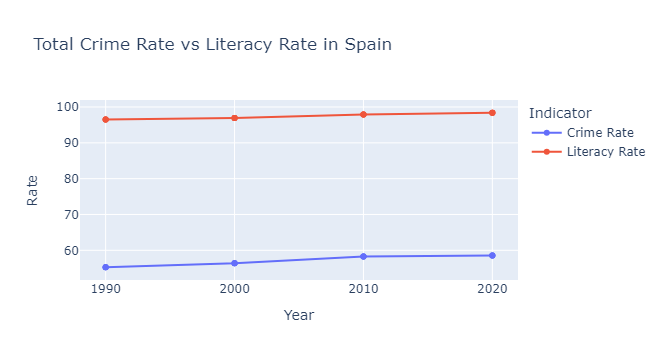

In [15]:
import plotly.express as px
import pandas as pd
df_peru = df[df['Country '] == 'Spain']


df_crime = df_peru.melt(id_vars=['Country ', 'Crime Category'], 
                         value_vars=['C.1990', 'C.2000', 'C.2010', 'C.2020'],
                         var_name='Year', value_name='Crime Rate')


df_crime['Year'] = df_crime['Year'].str.extract('(\d+)').astype(int)


df_crime_sum = df_crime.groupby(['Country ', 'Year'])['Crime Rate'].sum().reset_index()


df_literacy = df_peru.melt(id_vars=['Country '], 
                            value_vars=['L.1990', 'L.2000', 'L.2010', 'L.2020'],
                            var_name='Year', value_name='Literacy Rate')


df_literacy['Year'] = df_literacy['Year'].str.extract('(\d+)').astype(int)


df_peru_merged = pd.merge(df_crime_sum, df_literacy, on=['Country ', 'Year'])


fig = px.line(df_peru_merged, x='Year', y=['Crime Rate', 'Literacy Rate'], 
              labels={'value': 'Rate', 'variable': 'Indicator'},
              markers=True, title="Total Crime Rate vs Literacy Rate in Spain")

fig.show()

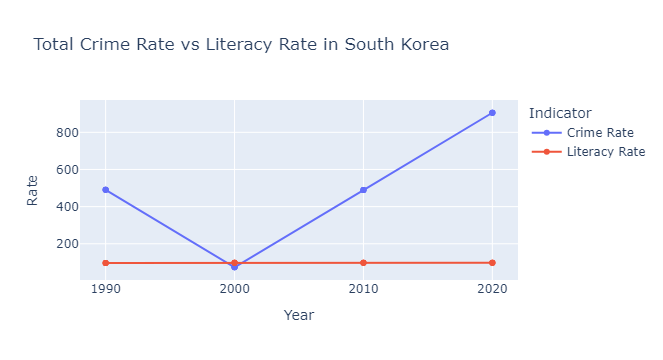

In [14]:
import plotly.express as px
import pandas as pd
df_peru = df[df['Country '] == 'South Korea']


df_crime = df_peru.melt(id_vars=['Country ', 'Crime Category'], 
                         value_vars=['C.1990', 'C.2000', 'C.2010', 'C.2020'],
                         var_name='Year', value_name='Crime Rate')


df_crime['Year'] = df_crime['Year'].str.extract('(\d+)').astype(int)


df_crime_sum = df_crime.groupby(['Country ', 'Year'])['Crime Rate'].sum().reset_index()


df_literacy = df_peru.melt(id_vars=['Country '], 
                            value_vars=['L.1990', 'L.2000', 'L.2010', 'L.2020'],
                            var_name='Year', value_name='Literacy Rate')


df_literacy['Year'] = df_literacy['Year'].str.extract('(\d+)').astype(int)


df_peru_merged = pd.merge(df_crime_sum, df_literacy, on=['Country ', 'Year'])


fig = px.line(df_peru_merged, x='Year', y=['Crime Rate', 'Literacy Rate'], 
              labels={'value': 'Rate', 'variable': 'Indicator'},
              markers=True, title="Total Crime Rate vs Literacy Rate in South Korea")

fig.show()

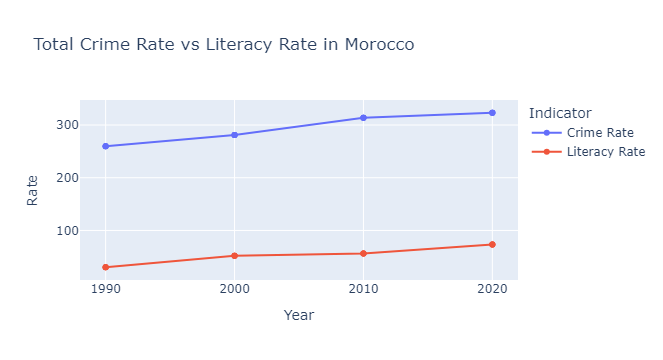

In [8]:
import plotly.express as px
import pandas as pd
df_peru = df[df['Country '] == 'Morocco']


df_crime = df_peru.melt(id_vars=['Country ', 'Crime Category'], 
                         value_vars=['C.1990', 'C.2000', 'C.2010', 'C.2020'],
                         var_name='Year', value_name='Crime Rate')


df_crime['Year'] = df_crime['Year'].str.extract('(\d+)').astype(int)


df_crime_sum = df_crime.groupby(['Country ', 'Year'])['Crime Rate'].sum().reset_index()


df_literacy = df_peru.melt(id_vars=['Country '], 
                            value_vars=['L.1990', 'L.2000', 'L.2010', 'L.2020'],
                            var_name='Year', value_name='Literacy Rate')


df_literacy['Year'] = df_literacy['Year'].str.extract('(\d+)').astype(int)


df_peru_merged = pd.merge(df_crime_sum, df_literacy, on=['Country ', 'Year'])


fig = px.line(df_peru_merged, x='Year', y=['Crime Rate', 'Literacy Rate'], 
              labels={'value': 'Rate', 'variable': 'Indicator'},
              markers=True, title="Total Crime Rate vs Literacy Rate in Morocco")

fig.show()

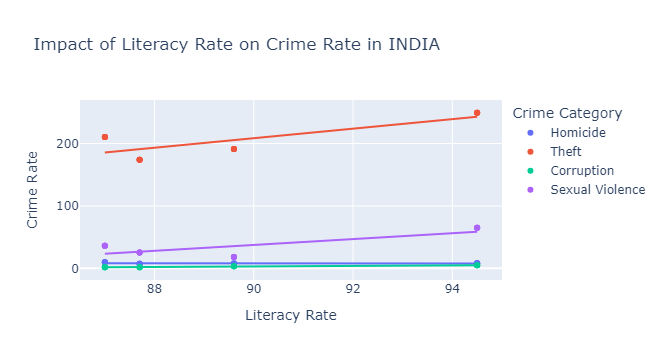

In [22]:

df_peru = df[df['Country '] == 'Peru']


df_crime = df_peru.melt(id_vars=['Country ', 'Crime Category'], 
                         value_vars=['C.1990', 'C.2000', 'C.2010', 'C.2020'],
                         var_name='Year', value_name='Crime Rate')


df_literacy = df_peru.melt(id_vars=['Country '], 
                            value_vars=['L.1990', 'L.2000', 'L.2010', 'L.2020'],
                            var_name='Year', value_name='Literacy Rate')


df_crime['Year'] = df_crime['Year'].str.extract('(\d+)').astype(int)
df_literacy['Year'] = df_literacy['Year'].str.extract('(\d+)').astype(int)


df_peru_merged = pd.merge(df_crime, df_literacy, on=['Country ', 'Year'])


fig = px.scatter(df_peru_merged, 
                 x='Literacy Rate', 
                 y='Crime Rate', 
                 color='Crime Category',  
                 size_max=10, 
                 hover_data=['Year', 'Crime Category'],
                 title="Impact of Literacy Rate on Crime Rate in INDIA",
                 trendline="ols")  # Adds a trend line

fig.show()


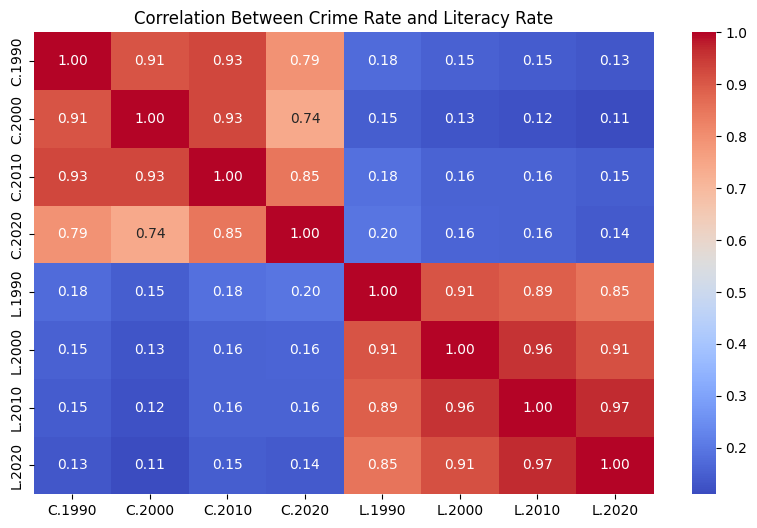

In [35]:


df_corr = df[['C.1990', 'C.2000', 'C.2010', 'C.2020', 
              'L.1990', 'L.2000', 'L.2010', 'L.2020']]

# Compute correlatio
correlation_matrix = df_corr.corr()


plt.figure(figsize=(10, 6))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title("Correlation Between Crime Rate and Literacy Rate")
plt.show()


C:\Users\itssa\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



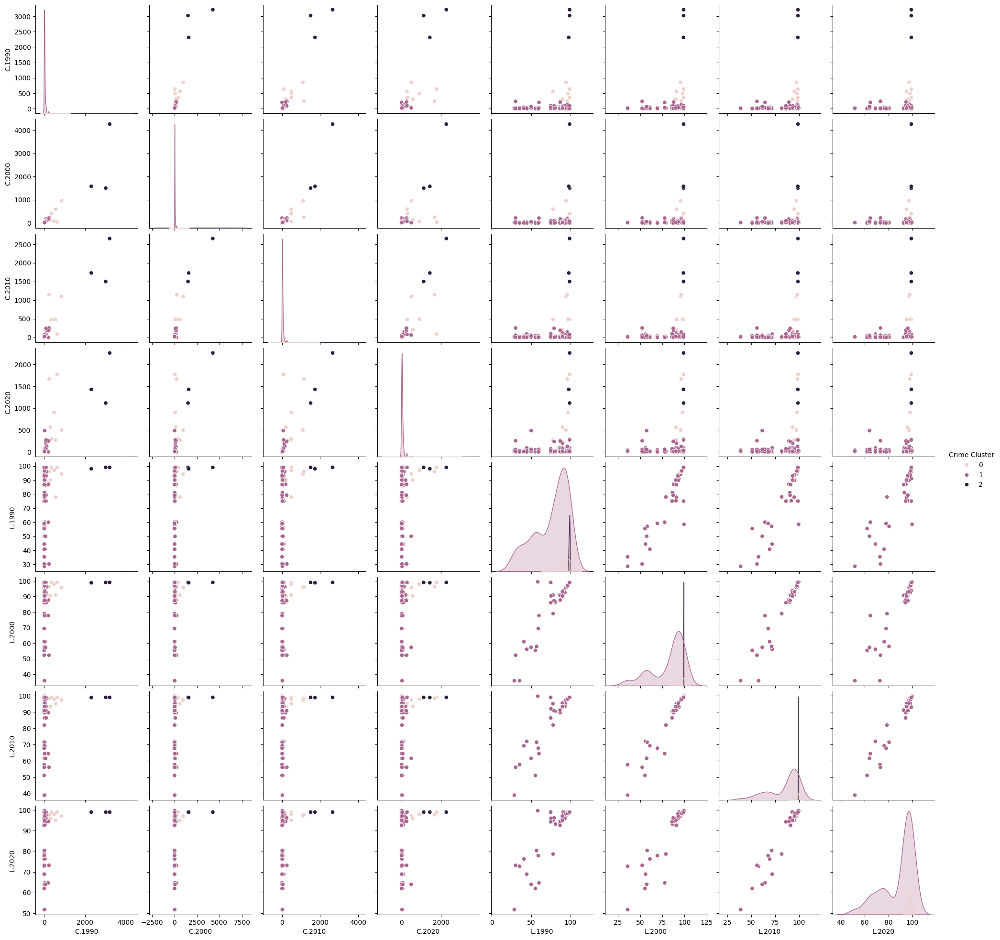

In [36]:
from sklearn.cluster import KMeans

# Selecting only crime columns
crime_data = df[['C.1990', 'C.2000', 'C.2010', 'C.2020']]

# K-Means clustering
kmeans = KMeans(n_clusters=3, random_state=42)
df['Crime Cluster'] = kmeans.fit_predict(crime_data)

# Visualizing clusters
sns.pairplot(df, hue="Crime Cluster", diag_kind='kde')
plt.show()


In [38]:
import pandas as pd

# Read your original data
data = pd.read_csv("C:/Users/itssa/OneDrive/Desktop/literacy_rateee.csv")  # Replace with your actual file path

# Step 1: Melt crime rate columns
crime_cols = ['C.1990', 'C.2000', 'C.2010', 'C.2020']
literacy_cols = ['L.1990', 'L.2000', 'L.2010', 'L.2020']

crime_melt = data.melt(id_vars=['Country ', 'Crime Category'], 
                       value_vars=crime_cols, 
                       var_name='Year', 
                       value_name='Crime Rate')

literacy_melt = data.melt(id_vars=['Country ', 'Crime Category'], 
                          value_vars=literacy_cols, 
                          var_name='Year', 
                          value_name='Literacy Rate')

# Step 2: Clean 'Year' column
crime_melt['Year'] = crime_melt['Year'].str.extract('(\d+)', expand=False).astype(int)
literacy_melt['Year'] = literacy_melt['Year'].str.extract('(\d+)', expand=False).astype(int)

# Step 3: Merge them
merged = pd.merge(crime_melt, literacy_melt, on=['Country ', 'Crime Category', 'Year'])

# Now merged dataframe has: Country, Crime Category, Year, Crime Rate, Literacy Rate


In [39]:
data.isnull().sum()

Country            0
Crime Category     0
C.1990            34
C.2000            10
C.2010             5
C.2020            15
L.1990             0
L.2000             0
L.2010             0
L.2020             0
dtype: int64

In [40]:

start_col = "C.1990"
end_col = "C.2020"


fill_columns = data.loc[:, start_col:end_col].columns


data[fill_columns] = data[fill_columns].apply(lambda row: row.fillna(row.mean()), axis=1)



In [41]:
data.isnull().sum()

Country           0
Crime Category    0
C.1990            0
C.2000            0
C.2010            0
C.2020            0
L.1990            0
L.2000            0
L.2010            0
L.2020            0
dtype: int64

In [42]:
# Drop rows where Crime Rate or Literacy Rate is missing
cleaned = merged.dropna(subset=['Crime Rate', 'Literacy Rate'])

# Features and target
X = cleaned[['Country ', 'Crime Category', 'Year', 'Literacy Rate']]
y = cleaned['Crime Rate']


In [43]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import r2_score, mean_absolute_error,mean_squared_error
from sklearn.preprocessing import OneHotEncoder
from sklearn.pipeline import make_pipeline
from sklearn.compose import ColumnTransformer

# Preprocessing
categorical_features = ['Country ', 'Crime Category']
preprocessor = ColumnTransformer([
    ('cat', OneHotEncoder(handle_unknown='ignore'), categorical_features)
], remainder='passthrough')

# Model pipeline
model = make_pipeline(preprocessor, RandomForestRegressor(n_estimators=100, random_state=42))

# Train/test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Fit and predict
model.fit(X_train, y_train)
y_pred = model.predict(X_test)

# Evaluate
print("R² Score:", r2_score(y_test, y_pred))
print("MAE:", mean_absolute_error(y_test, y_pred))


R² Score: 0.9282066143837316
MAE: 34.6597566972477


Not enough data points for extrapolation or prediction.


In [29]:
# Check how many valid rows exist for Vietnam - Theft
country = 'Vietnam'
category = 'Theft'

subset_check = merged[(merged['Country '] == country) & 
                      (merged['Crime Category'] == category)]

print("Total rows:", subset_check.shape[0])
print("Rows with non-null Crime Rate and Literacy Rate:")
print(subset_check.dropna(subset=['Crime Rate', 'Literacy Rate']))


Total rows: 0
Rows with non-null Crime Rate and Literacy Rate:
Empty DataFrame
Columns: [Country , Crime Category, Year, Crime Rate, Literacy Rate]
Index: []


In [30]:
top_combos = merged.dropna(subset=['Crime Rate', 'Literacy Rate']) \
                   .groupby(['Country ', 'Crime Category']).size() \
                   .sort_values(ascending=False).head(5)
print(top_combos)


Country       Crime Category
Argentina     Corruption        4
Nigeria       Homicide          4
South Africa  Corruption        4
Russia        Theft             4
              Homicide          4
dtype: int64


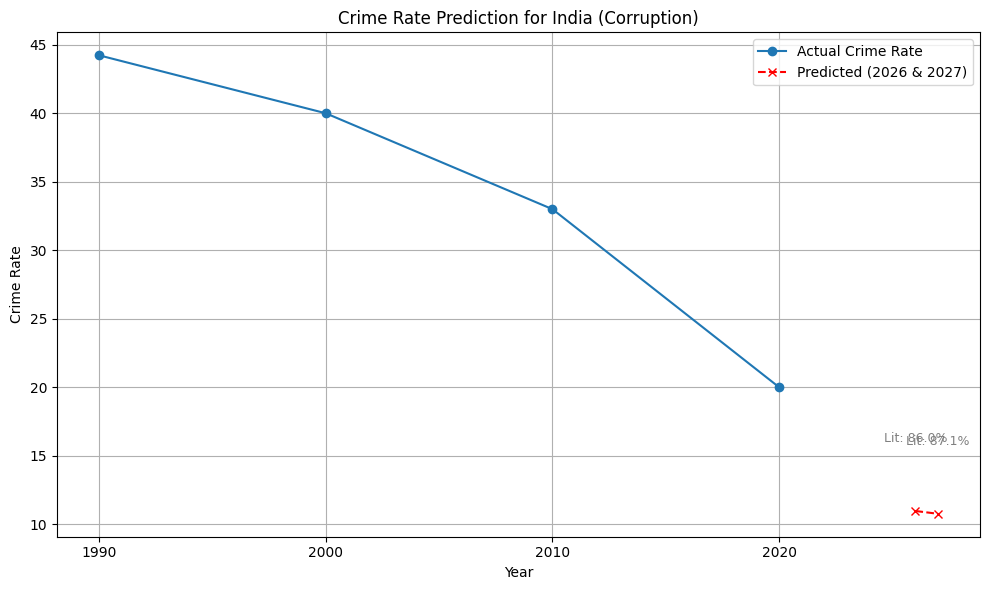

Predicted Crime Rate in India (Corruption) for 2026: 10.98
Predicted Crime Rate in India (Corruption) for 2027: 10.78


In [17]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.linear_model import LinearRegression

# Filter actual data for Vietnam - Theft
country = 'India'
category = 'Corruption'

subset = merged[(merged['Country '] == country) & 
                (merged['Crime Category'] == category)].dropna(subset=['Crime Rate', 'Literacy Rate'])

# Ensure the data is sorted by Year
subset = subset.sort_values('Year')

# Check if we have enough data
if len(subset) < 2:
    print("Not enough data points for extrapolation or prediction.")
else:
    # Extrapolate literacy rate
    years = subset['Year'].values.reshape(-1, 1)
    lit_rates = subset['Literacy Rate'].values

    linreg = LinearRegression()
    linreg.fit(years, lit_rates)

    future_years = np.array([2026, 2027]).reshape(-1, 1)
    future_lit = linreg.predict(future_years)

    # Prepare dataframe for prediction
    future_df = pd.DataFrame({
        'Country ': [country] * len(future_years),
        'Crime Category': [category] * len(future_years),
        'Year': future_years.flatten(),
        'Literacy Rate': future_lit
    })

    # Predict future crime rates
    future_pred = model.predict(future_df)

    # Plot actual + predicted values
    plt.figure(figsize=(10, 6))
    plt.plot(subset['Year'], subset['Crime Rate'], marker='o', label='Actual Crime Rate')
    plt.plot(future_years, future_pred, marker='x', linestyle='--', color='red', label='Predicted (2026 & 2027)')
    
    # Plot future literacy as annotations
    for year, rate, lit in zip(future_years.flatten(), future_pred, future_lit):
        plt.text(year, rate + 5, f'Lit: {lit:.1f}%', color='gray', fontsize=9, ha='center')

    plt.title(f'Crime Rate Prediction for {country} ({category})')
    plt.xlabel('Year')
    plt.ylabel('Crime Rate')
    plt.xticks(np.arange(1990, 2029, 10))
    plt.grid(True)
    plt.legend()
    plt.tight_layout()
    plt.show()
for year, rate in zip(future_df['Year'], future_pred):
    print(f"Predicted Crime Rate in {country } ({category}) for {year}: {rate:.2f}")


In [23]:
# Plot future literacy as annotations with slight offsets
offsets = [-3, +3]  # Adjust Y-axis offset to avoid overlap
for i, (year, rate, lit) in enumerate(zip(future_years.flatten(), future_pred, future_lit)):
    plt.text(year + 0.3, rate + offsets[i], f'Lit: {lit:.1f}%', color='gray', fontsize=9, ha='center')


ValueError: Image size of 1005624x5144 pixels is too large. It must be less than 2^16 in each direction.

<Figure size 640x480 with 1 Axes>

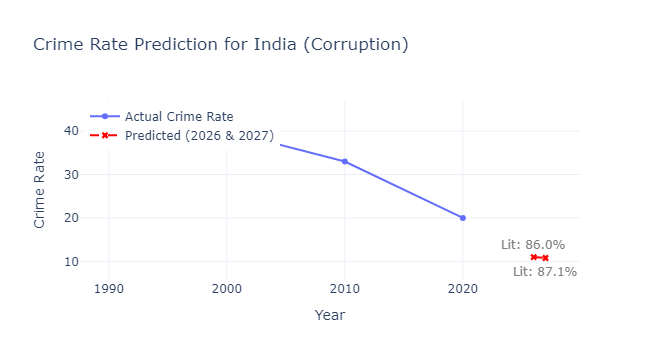

In [21]:
import plotly.graph_objects as go

# Add annotations
annotations = []
for i, (year, rate, lit) in enumerate(zip(future_years.flatten(), future_pred, future_lit)):
    annotations.append(dict(
        x=year,
        y=rate + (3 if i % 2 == 0 else -3),  # alternate offset
        text=f"Lit: {lit:.1f}%",
        showarrow=False,
        font=dict(size=12, color="gray")
    ))

fig.update_layout(annotations=annotations)


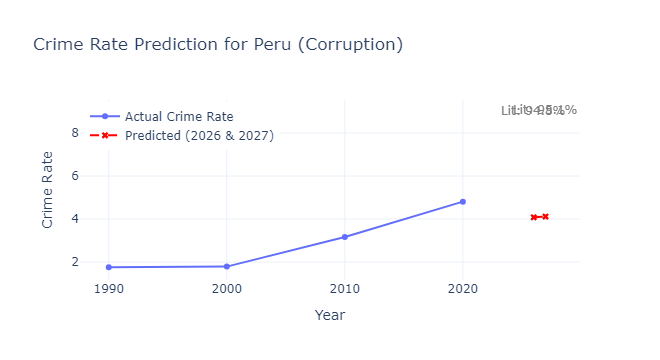

Predicted Crime Rate in Peru (Corruption) for 2026: 4.08
Predicted Crime Rate in Peru (Corruption) for 2027: 4.12


In [35]:
import numpy as np
import pandas as pd
import plotly.graph_objects as go
from sklearn.linear_model import LinearRegression

# Filter actual data for India - Corruption
country = 'Peru'
category = 'Corruption'

subset = merged[(merged['Country '] == country) & 
                (merged['Crime Category'] == category)].dropna(subset=['Crime Rate', 'Literacy Rate'])

# Ensure the data is sorted by Year
subset = subset.sort_values('Year')


# Check if we have enough data
if len(subset) < 2:
    print("Not enough data points for extrapolation or prediction.")
else:
    # Extrapolate literacy rate
    years = subset['Year'].values.reshape(-1, 1)
    lit_rates = subset['Literacy Rate'].values

    linreg = LinearRegression()
    linreg.fit(years, lit_rates)

    future_years = np.array([2026, 2027]).reshape(-1, 1)
    future_lit = linreg.predict(future_years)

    # Prepare dataframe for prediction
    future_df = pd.DataFrame({
        'Country ': [country] * len(future_years),
        'Crime Category': [category] * len(future_years),
        'Year': future_years.flatten(),
        'Literacy Rate': future_lit
    })

    # Predict future crime rates
    future_pred = model.predict(future_df)

    # Plotly figure
    fig = go.Figure()

    # Actual Crime Rate
    fig.add_trace(go.Scatter(
        x=subset['Year'], 
        y=subset['Crime Rate'], 
        mode='lines+markers',
        name='Actual Crime Rate'
    ))

    # Predicted Crime Rate
    fig.add_trace(go.Scatter(
        x=future_years.flatten(), 
        y=future_pred, 
        mode='lines+markers',
        name='Predicted (2026 & 2027)',
        line=dict(dash='dash', color='red'),
        marker=dict(symbol='x')
    ))

    # Add annotations for predicted literacy rate
    for year, rate, lit in zip(future_years.flatten(), future_pred, future_lit):
        fig.add_annotation(
            x=year, y=rate + 5,
            text=f'Lit: {lit:.1f}%',
            showarrow=False,
            font=dict(color='gray')
        )

    # Layout settings
    fig.update_layout(
        title=f'Crime Rate Prediction for {country} ({category})',
        xaxis_title='Year',
        yaxis_title='Crime Rate',
        xaxis=dict(dtick=10),
        legend=dict(x=0.01, y=0.99),
        template='plotly_white'
    )

    fig.show()

    # Print predicted values
    for year, rate in zip(future_df['Year'], future_pred):
        print(f"Predicted Crime Rate in {country} ({category}) for {year}: {rate:.2f}")


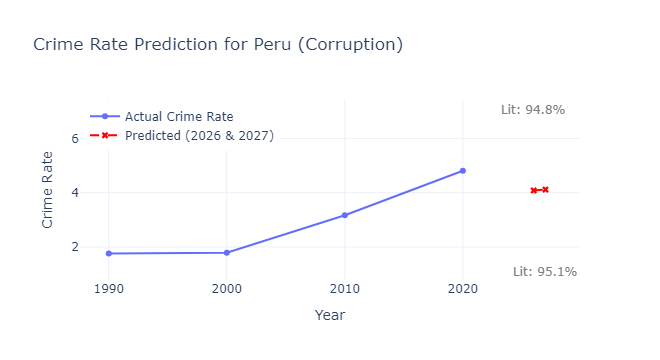

In [29]:
import plotly.graph_objects as go

# Add annotations
annotations = []
for i, (year, rate, lit) in enumerate(zip(future_years.flatten(), future_pred, future_lit)):
    annotations.append(dict(
        x=year,
        y=rate + (3 if i % 2 == 0 else -3),  # alternate offset
        text=f"Lit: {lit:.1f}%",
        showarrow=False,
        font=dict(size=12, color="gray")
    ))

fig.update_layout(annotations=annotations)

Predicted Crime Rate in Mexico (Corruption) for 2026: 20.59
Predicted Crime Rate in Mexico (Corruption) for 2027: 20.60


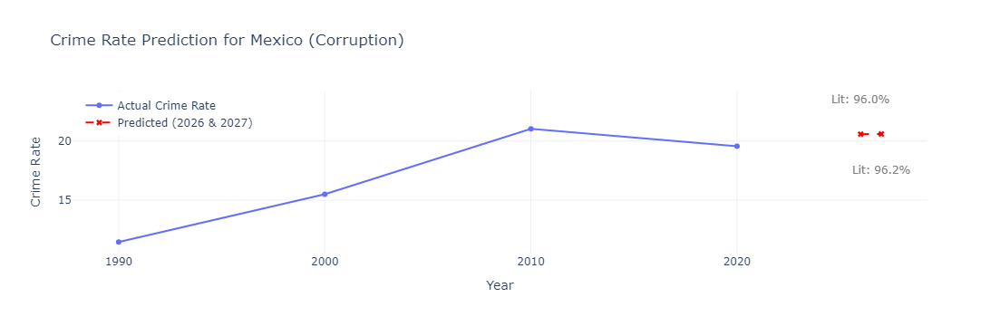

In [36]:
import plotly.graph_objects as go
from sklearn.linear_model import LinearRegression

# Filter actual data for India - Corruption
country = 'Mexico'
category = 'Corruption'

subset = merged[(merged['Country '] == country) & 
                (merged['Crime Category'] == category)].dropna(subset=['Crime Rate', 'Literacy Rate'])

# Ensure the data is sorted by Year
subset = subset.sort_values('Year')


# Check if we have enough data
if len(subset) < 2:
    print("Not enough data points for extrapolation or prediction.")
else:
    # Extrapolate literacy rate
    years = subset['Year'].values.reshape(-1, 1)
    lit_rates = subset['Literacy Rate'].values

    linreg = LinearRegression()
    linreg.fit(years, lit_rates)

    future_years = np.array([2026, 2027]).reshape(-1, 1)
    future_lit = linreg.predict(future_years)

    # Prepare dataframe for prediction
    future_df = pd.DataFrame({
        'Country ': [country] * len(future_years),
        'Crime Category': [category] * len(future_years),
        'Year': future_years.flatten(),
        'Literacy Rate': future_lit
    })

    # Predict future crime rates
    future_pred = model.predict(future_df)

    # Plotly figure
    fig = go.Figure()

    # Actual Crime Rate
    fig.add_trace(go.Scatter(
        x=subset['Year'], 
        y=subset['Crime Rate'], 
        mode='lines+markers',
        name='Actual Crime Rate'
    ))

    # Predicted Crime Rate
    fig.add_trace(go.Scatter(
        x=future_years.flatten(), 
        y=future_pred, 
        mode='lines+markers',
        name='Predicted (2026 & 2027)',
        line=dict(dash='dash', color='red'),
        marker=dict(symbol='x')
    ))

    # Add annotations for predicted literacy rate
    for year, rate, lit in zip(future_years.flatten(), future_pred, future_lit):
        fig.add_annotation(
            x=year, y=rate + 5,
            text=f'Lit: {lit:.1f}%',
            showarrow=False,
            font=dict(color='gray')
        )

    # Layout settings
    fig.update_layout(
        title=f'Crime Rate Prediction for {country} ({category})',
        xaxis_title='Year',
        yaxis_title='Crime Rate',
        xaxis=dict(dtick=10),
        legend=dict(x=0.01, y=0.99),
        template='plotly_white'
    )

    

    # Print predicted values
    for year, rate in zip(future_df['Year'], future_pred):
        print(f"Predicted Crime Rate in {country} ({category}) for {year}: {rate:.2f}")
    annotations = []
for i, (year, rate, lit) in enumerate(zip(future_years.flatten(), future_pred, future_lit)):
    annotations.append(dict(
        x=year,
        y=rate + (3 if i % 2 == 0 else -3),  # alternate offset
        text=f"Lit: {lit:.1f}%",
        showarrow=False,
        font=dict(size=12, color="gray")
    ))

fig.update_layout(annotations=annotations)


Predicted Crime Rate in Turkey (Corruption) for 2026: 7.05
Predicted Crime Rate in Turkey (Corruption) for 2027: 7.05


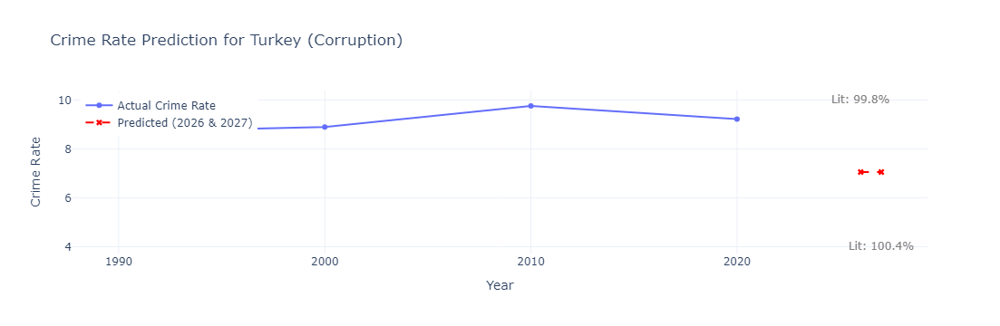

In [40]:
import plotly.graph_objects as go
from sklearn.linear_model import LinearRegression

# Filter actual data for India - Corruption
country = 'Turkey'
category = 'Corruption'

subset = merged[(merged['Country '] == country) & 
                (merged['Crime Category'] == category)].dropna(subset=['Crime Rate', 'Literacy Rate'])

# Ensure the data is sorted by Year
subset = subset.sort_values('Year')


# Check if we have enough data
if len(subset) < 2:
    print("Not enough data points for extrapolation or prediction.")
else:
    # Extrapolate literacy rate
    years = subset['Year'].values.reshape(-1, 1)
    lit_rates = subset['Literacy Rate'].values

    linreg = LinearRegression()
    linreg.fit(years, lit_rates)

    future_years = np.array([2026, 2027]).reshape(-1, 1)
    future_lit = linreg.predict(future_years)

    # Prepare dataframe for prediction
    future_df = pd.DataFrame({
        'Country ': [country] * len(future_years),
        'Crime Category': [category] * len(future_years),
        'Year': future_years.flatten(),
        'Literacy Rate': future_lit
    })

    # Predict future crime rates
    future_pred = model.predict(future_df)

    # Plotly figure
    fig = go.Figure()

    # Actual Crime Rate
    fig.add_trace(go.Scatter(
        x=subset['Year'], 
        y=subset['Crime Rate'], 
        mode='lines+markers',
        name='Actual Crime Rate'
    ))

    # Predicted Crime Rate
    fig.add_trace(go.Scatter(
        x=future_years.flatten(), 
        y=future_pred, 
        mode='lines+markers',
        name='Predicted (2026 & 2027)',
        line=dict(dash='dash', color='red'),
        marker=dict(symbol='x')
    ))

    # Add annotations for predicted literacy rate
    for year, rate, lit in zip(future_years.flatten(), future_pred, future_lit):
        fig.add_annotation(
            x=year, y=rate + 5,
            text=f'Lit: {lit:.1f}%',
            showarrow=False,
            font=dict(color='gray')
        )

    # Layout settings
    fig.update_layout(
        title=f'Crime Rate Prediction for {country} ({category})',
        xaxis_title='Year',
        yaxis_title='Crime Rate',
        xaxis=dict(dtick=10),
        legend=dict(x=0.01, y=0.99),
        template='plotly_white'
    )

    

    # Print predicted values
    for year, rate in zip(future_df['Year'], future_pred):
        print(f"Predicted Crime Rate in {country} ({category}) for {year}: {rate:.2f}")
    annotations = []
for i, (year, rate, lit) in enumerate(zip(future_years.flatten(), future_pred, future_lit)):
    annotations.append(dict(
        x=year,
        y=rate + (3 if i % 2 == 0 else -3),  # alternate offset
        text=f"Lit: {lit:.1f}%",
        showarrow=False,
        font=dict(size=12, color="gray")
    ))

fig.update_layout(annotations=annotations)
